In [ ]:
# BL531 commissioning
# matt landsman and jonathan chan
# may 22+23, 2024

In [2]:
import epics
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from time import sleep as time_sleep
import pandas as pd
import fabio
import pyFAI
from pyFAI.calibrant import get_calibrant
from pyFAI.azimuthalIntegrator import AzimuthalIntegrator
from matplotlib.colors import LogNorm

from tqdm import tqdm

from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.colorbar import Colorbar as colorbar
from matplotlib.colors import LogNorm


%matplotlib inline

In [ ]:
# pumping/venting directions:
    # load sample
    # turn on roughing pump (make sure the N2 is off and the sample chamber is closed, pressure should decrease when you turn the pump on)
    # wait 30-45 min until you reach <400 mTorr
    # turn on turbomolecular pump
    # turn on chiller
    # once gauge reads zero, you can turn on the camera switches
    # search hutch
    # start up camera on terminal
        # ./runtvx --> good to start here to take test images and make sure detector is good to go
        # then close the runtvx terminal and run "xterm -geometry 80x40+20-5 -e camserver &" to work in epics

# venting directions:
    # close shutter and enter hutch
    # switch cameras off --> check the computer to ensure its disconnected
    # switch chiller off
    # turn off the turbomolecular pump, wait for LEVITATION
    # turn off the roughing pump
    # open N2 valve
    # open the sample chamber so pressure doesnt build up once vacuum is gone
    # once the sample chamber opens, turn off the N2 and leave chamber vented 

In [ ]:
# if the Pilatus detector is not connected in EPICS
    # ./runtvx on the pilatus computer (and then close tvx, or just run camserver)
    # on main computer, go to the terminal with iocPilatus (this should always be running)
    # run the ./st.cmd   (once detector is on)

In [7]:
# --------------------------------------------------------------------------------------------------------------------------------------------------------------

# define mono angle to energy conversion

#physical constants
h_m2kgps = 6.6261e-34
c_mps    = 299792458   
e_eV     = 6.2415e+18
# Silicon spacing (for Bragg condition)
Si_m = 5.43E-10
a_Si111_m = Si_m/np.sqrt(1^2+1^2+1^2)
# Monochromotor offset
mono_offset_deg = 12.787
#Wavelength from energy
lambda_m = lambda E_eV : h_m2kgps*c_mps*e_eV/E_eV
#Bragg angle from Wavelength
bragg_deg = lambda E_eV: np.arcsin(lambda_m(E_eV)/(2*a_Si111_m))*180/np.pi
# Mono angle from Bragg angle
mono_deg = lambda E_eV: bragg_deg(E_eV)+mono_offset_deg

# inverse function to go from mono angle to eV
energy_eV = lambda mono_deg_input: (h_m2kgps*c_mps*e_eV)/((2 * a_Si111_m) * np.sin((np.pi/180)*(mono_deg_input - mono_offset_deg)))



In [84]:
# move the beamstop on SAXS detector (to block direct beam)
epics.caput('bl531_xps2:beamstop_x_mm', 12)

1

In [72]:
epics.caget('bl531_xps2:beamstop_x_mm')
epics.caget('bl531_xps2:beamstop_y_mm')

CA.Client.Exception...............................................
    Context: "Channel: "bl531_xps2:beamstop_x_mm", Connecting to: 131.243.80.239:35017, Ignored: 192.168.10.123:35017"
    Source File: ../cac.cpp line 1320
    Current Time: Wed May 22 2024 11:16:35.853451532
..................................................................


12.5

In [140]:
# set the mono angle
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8800))

# print mono angle for reference
epics.caget('bl531_xps1:mono_angle_deg')


25.772624731024827

In [106]:
# slits

    # E = endstation slits inboard     positive movement moves it RIGHT (opens left slit)
    # F = endstation slits outboard    positive movement moves it LEFT (opens right slit)
    # G = endstation slits Top         positive movement moves it UP (opens top slit) 
    # H = endstation slits Bottom      positive movement moves it UP (closes bottom slit)

# first make sure they are enabled
epics.caput('DMC02:E.CNEN', 1)
epics.caput('DMC02:F.CNEN', 1)
epics.caput('DMC02:G.CNEN', 1)
epics.caput('DMC02:H.CNEN', 1)


slit_left_pos = epics.caget('DMC02:E')
slit_right_pos = epics.caget('DMC02:F')
slit_top_pos = epics.caget('DMC02:G')
slit_bot_pos = epics.caget('DMC02:H')

print(f'Slit positions: \nLeft (E): {slit_left_pos} mm\nRight (F): {slit_right_pos} mm\nTop (G): {slit_top_pos} mm\nBottom (H): {slit_bot_pos} mm' )

Slit positions: 
Left (E): -25.0 mm
Right (F): 20.0 mm
Top (G): -30.0 mm
Bottom (H): 0.0025 mm


In [99]:
#epics.caput('DMC02:E', -25)
    # anything above -20 introduces junk to the beam profile

#epics.caput('DMC02:F', 20)
    # anything below 20 seems to be the same on pilatus

#epics.caput('DMC02:G', -30)
    # anything above -25 introduces junk to the beam profile

#epics.caput('DMC02:H', -5)
    # this one does not respond to movements!!!!!



1

In [105]:
# do not touch these slits    wont work anyway     they filter the beam

epics.caput('DMC01:A.CNEN', 1)
epics.caput('DMC01:B.CNEN', 1)
epics.caput('DMC01:C.CNEN', 1)
epics.caput('DMC01:D.CNEN', 1)

cannot connect to DMC01:A.CNEN
cannot connect to DMC01:B.CNEN
cannot connect to DMC01:C.CNEN
cannot connect to DMC01:D.CNEN


In [ ]:
# --------------------------------------------------------------------------------------------------------------------------------------------------------------
# bar 1
    # Copper Acetate
    # AgB
    # Jonathan's Ag sample from jeff longs group



In [190]:
# quick Cu K-edge NEXAFS scan on CuAc to see if we see an edge, then detailed Cu K-edge

input_energies = np.linspace(8810, 8860, 51)   # nexafs Cu K-edge quick

input_energies = np.linspace(8750, 8950, 201)   # nexafs Cu K-edge


time_sleep_variable = 1


mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)    
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4


file_name = 'cu_is_working_CuAc_may22_mrl'
np.savetxt(f'/home/bl531/bl531_commissioning/20240424ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')







100%|██████████| 201/201 [20:07<00:00,  6.01s/it]

done


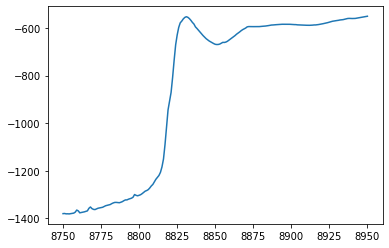

In [191]:
plt.plot(input_energies[:], pd_val_nA[:])

# nice Cu K-edge spectra on Copper Acetate reference powder

In [ ]:
# moved to jonathan's sample, lets try Ag L-edge

In [179]:
# set the mono angle
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8000))

time_sleep(2)

# print mono angle for reference
epics.caget('bl531_xps1:mono_angle_deg')


# were able to get down to 5 or 6 keV before the beam really dies off on the Pilatus detector


27.097538443499513

In [ ]:
# passing off to Antoine 1 pm

# mrl --> collect AgB calibration scans on Pilatus this evening!!

AIW takes over and breaks everything you hold dear 

In [194]:
# speed test
reading_ma = ()
for i_r in range(100):
    epics.caget('bl201-beamstop:current')

In [209]:
# single image acquisition on saxs detector
epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

/mnt/data531/testabc_4823.tif 


In [208]:
# single image acquisition on waxs detector
epics.caput('pilatus300k:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

/mnt/data531/WAXS531_016.tif 


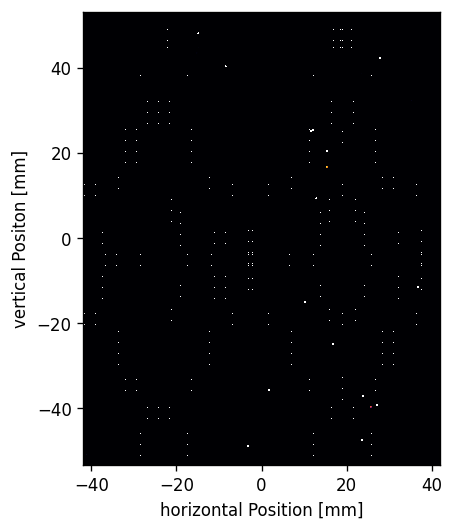

In [211]:
filepath = '/mnt/data531/WAXS531_016.tif'


# read the image
im_tiff = Image.open(filepath)
# make the image a numpy array so that we can process it
im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))

# dealing with dyanmic range
#im_np[np.where(im_np>100000.0)] =0

dx_m = 172e-6
Nx_px = 487
Ny_px = 619
Dx_m = Nx_px*dx_m
Dy_m = Ny_px*dx_m

fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

plt.imshow(im_np, extent=extent, cmap = 'inferno', norm=LogNorm())
plt.xlabel('horizontal Position [mm]')
plt.ylabel('vertical Positon [mm]')
plt.show()

In [ ]:
# matt is back 6 pm
# saxs and waxs detectors are mounted

In [214]:
#epics.caget('bl531_xps1:mono_angle_deg')
energy_eV(epics.caget('bl531_xps1:mono_angle_deg'))
#epics.caput('bl531_xps1:mono_angle_deg', mono_deg(7000))

6999.90416264673

In [ ]:
# purging N2 into the chamber before pumping down seems to speed it up????




# new day may 23 beam is back after the power disruption

In [221]:
# Cu K-edge NEXAFS on Cu(I) chloride


input_energies = np.linspace(8750, 8950, 201)   # nexafs Cu K-edge


time_sleep_variable = 1


mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)    
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4


file_name = 'cu_one_may23_mrl'
np.savetxt(f'/home/bl531/bl531_commissioning/20240424ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')







 33%|███▎      | 67/201 [06:42<13:26,  6.02s/it]CA.Client.Exception...............................................
    Context: "192.168.10.75:5064"
    Source File: ../cac.cpp line 1237
    Current Time: Thu May 23 2024 09:12:24.766391542
..................................................................
CA.Client.Exception...............................................
    Context: "ppu088.dhcp.lbl.gov:5064"
    Source File: ../cac.cpp line 1237
    Current Time: Thu May 23 2024 09:12:24.767136067
..................................................................
 34%|███▍      | 68/201 [06:48<13:20,  6.02s/it]CA.Client.Exception...............................................
    Context: "Channel: "13PIL1:cam1:Acquire", Connecting to: 131.243.80.244:5064, Ignored: 192.168.10.75:5064"
    Source File: ../cac.cpp line 1320
    Current Time: Thu May 23 2024 09:12:31.798236559
..................................................................
CA.Client.Exception.........................

done


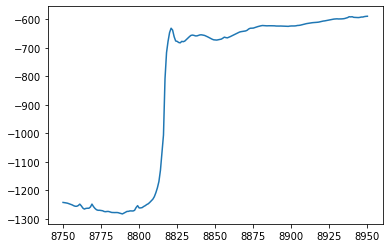

In [222]:
plt.plot(input_energies[:], pd_val_nA[:])



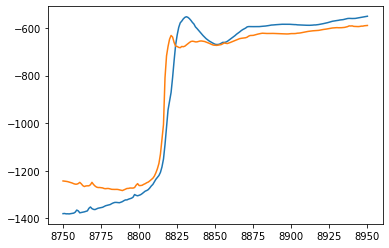

In [242]:
# compare Cu(I) and Cu(II)

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path))

fig, ax = plt.subplots()

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [250]:
# set the mono angle
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(5800))

time_sleep(2)

# print mono angle for reference
energy_eV(epics.caget('bl531_xps1:mono_angle_deg'))



5800.0

In [252]:
# lets try to find Cr K-edge (6.0 keV)

input_energies = np.linspace(5800, 6000, 101)   # nexafs Cr K-edge lets find it
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    #nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    #nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    #nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)    
    #pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4
    pd_val_nA[i_a] = nexafs_reading_1
file_name = 'cr_test'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')


100%|██████████| 101/101 [03:22<00:00,  2.01s/it]

done


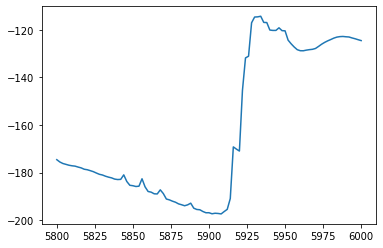

In [253]:
plt.plot(input_energies[:], pd_val_nA[:])


In [257]:
# now more refined Cr K-edge scan, going forward and reverse

# forward
input_energies = np.linspace(5890, 6090, 201)   # nexafs Cr K-edge 
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'cr_3_oxide_forward'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(6090, 5890, 201)   # nexafs Cr K-edge 
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'cr_3_oxide_reverse'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')


100%|██████████| 201/201 [13:25<00:00,  4.01s/it]

done


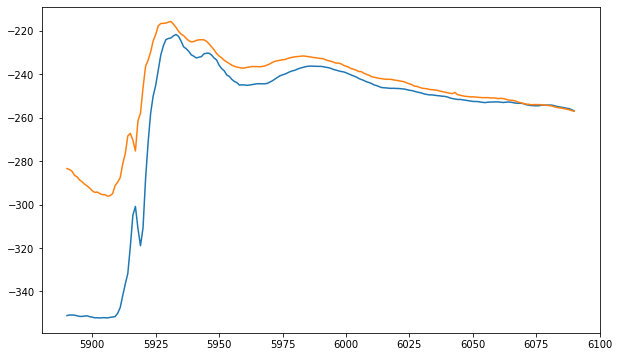

In [260]:
# Cr(III) oxide forward and reverse scans

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'cr' in f and 'test' not in f)

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


(5900.0, 5950.0)

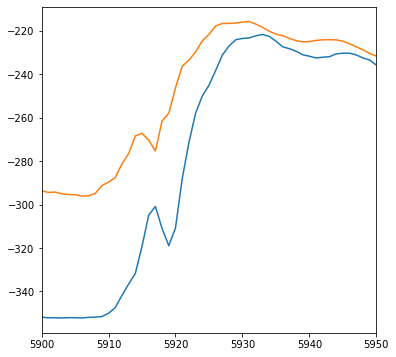

In [262]:
# Cr(III) oxide forward and reverse scans

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'cr' in f and 'test' not in f)

fig, ax = plt.subplots(figsize=(6,6))


for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])
ax.set_xlim([5900, 5950])

In [ ]:
# new bar
    # copper(ii) chloride
    # chromium(vi) oxide
    # copper(0) metal

In [263]:
# now more refined Cr K-edge scan, going forward and reverse

# forward
input_energies = np.linspace(5890, 6090, 201)   # nexafs Cr K-edge 
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'nexafs_Cr_Cr6oxide_forward'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(6090, 5890, 201)   # nexafs Cr K-edge 
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'nexafs_Cr_Cr6oxide_reverse'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')




100%|██████████| 201/201 [13:25<00:00,  4.01s/it]

done


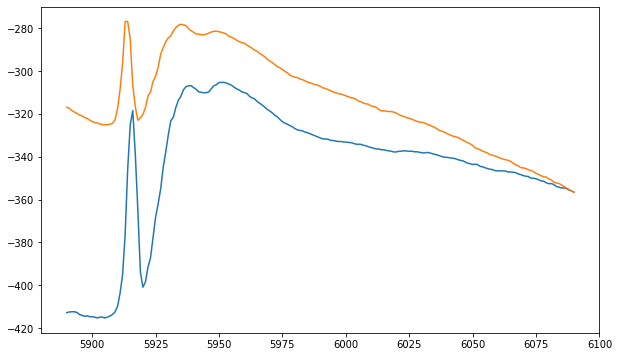

In [264]:
# Cr(VI) oxide forward and reverse scans

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'Cr6oxide' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


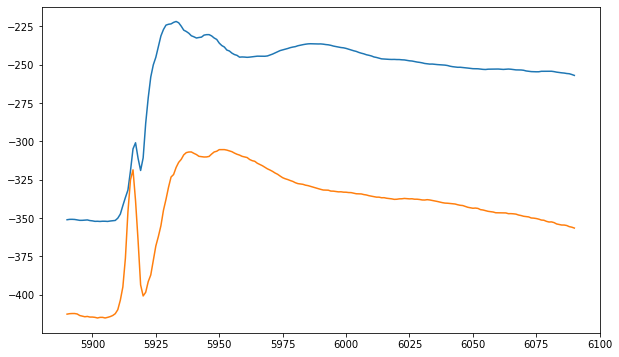

In [265]:
# Cr(VI) oxide forward and reverse scans

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'forward' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [266]:
# now more refined Cu K-edge scan, going forward and reverse
# this sample is Cu metal (0 oxidation state)

# forward
input_energies = np.linspace(8750, 8950, 201)   # nexafs Cu K-edge
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'cu_metal_forward'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(8950, 8750, 201)   # nexafs Cu K-edge
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'cu_metal_reverse'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')


100%|██████████| 201/201 [10:03<00:00,  3.00s/it]

done


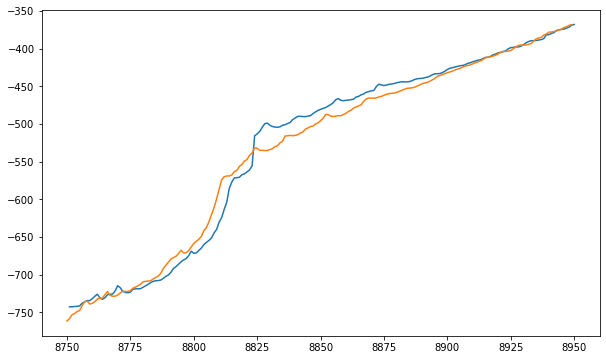

In [270]:
# copper metal nexafs - forward and reverse

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'cu_metal' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[1:,0], data[1:, 2])


In [268]:
# now more refined Cu K-edge scan, going forward and reverse
# this sample is Cu 2 chloride


# forward
input_energies = np.linspace(8750, 8950, 201)   # nexafs Cu K-edge
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'cu_chloride_forward'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(8950, 8750, 201)   # nexafs Cu K-edge
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    #time_sleep(time_sleep_variable)
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2
file_name = 'cu_chloride_reverse'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')


  1%|          | 2/201 [00:08<13:28,  4.06s/it]


KeyboardInterrupt: 

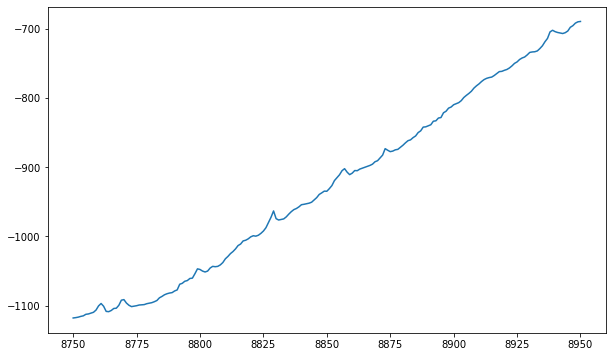

In [269]:
# kapton blank - forward and reverse

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'cu_chloride' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [271]:
# now more refined Cu K-edge scan, going forward and reverse
# kapton blank sample


# forward
input_energies = np.linspace(8750, 8950, 201)   # nexafs Cu K-edge
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    pd_val_nA[i_a] = nexafs_reading_1
file_name = 'kapton_forward1'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(8950, 8750, 201)   # nexafs Cu K-edge
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    pd_val_nA[i_a] = nexafs_reading_1 
file_name = 'kapton_reverse1'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')


  0%|          | 1/201 [00:02<09:16,  2.78s/it]


KeyboardInterrupt: 

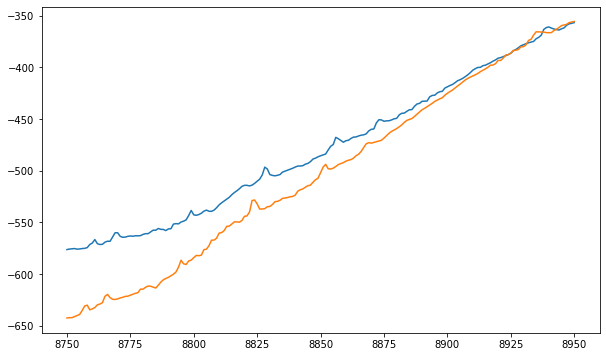

In [272]:
# kapton blank - forward and reverse

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'kapton' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [ ]:
# new bar
    # mostafa's gypsum-scaled xle membrane
    # iron(iii) phosphate
    # lithium iron(ii) phosphate

In [277]:
# start w Fe K-edge NEXAFS scans on Fe materials
# of course the shutters close 2 mins into this scan :)

input_energies = np.linspace(6950, 7150, 101)   # nexafs
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2

file_name = 'nexafs_Fe_Iron3phosphate_forward'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)




 54%|█████▍    | 55/101 [02:47<02:19,  3.04s/it]


KeyboardInterrupt: 

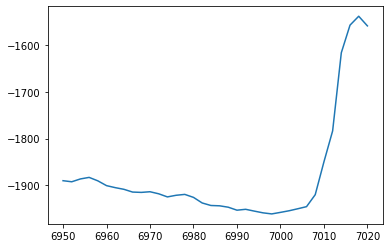

In [285]:
when_did_beam_dump = 36

plt.plot(input_energies[:when_did_beam_dump], pd_val_nA[:when_did_beam_dump])


In [286]:
# back an hour later to do Fe K-edge NEXAFS scans

# forward
input_energies = np.linspace(6950, 7150, 101)   
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')

    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4

file_name = 'nexafs_Fe_iron2phosphate_forward'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(7150, 6950, 101) 
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4
    
file_name = 'nexafs_Fe_iron2phosphate_reverse'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')



100%|██████████| 101/101 [08:25<00:00,  5.01s/it]

done


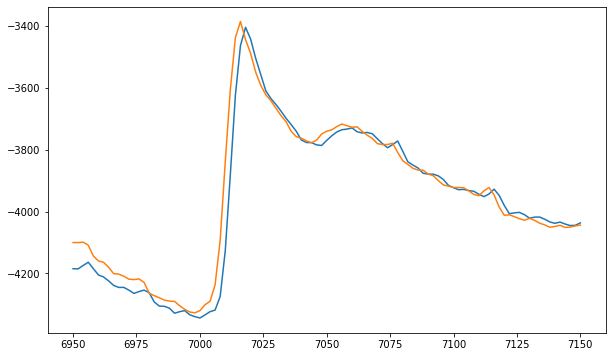

In [287]:
# lithium iron(II) phosphate

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'nexafs_Fe_iron2phosphate_' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [288]:
# move to next sample, iron(iii) phosphate



# forward
input_energies = np.linspace(6950, 7150, 101)   
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')

    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4

file_name = 'nexafs_Fe_iron3phosphate_forward1'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

# reverse reverse!
input_energies = np.linspace(7150, 6950, 101) 
time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4
    
file_name = 'nexafs_Fe_iron3phosphate_reverse1'
np.savetxt(f'/home/bl531/bl531_commissioning/20240522ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')



100%|██████████| 101/101 [08:25<00:00,  5.01s/it]

done


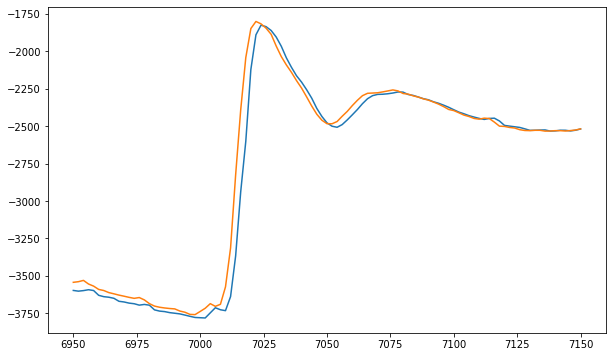

In [289]:
# lithium iron(II) phosphate

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'nexafs_Fe_iron3phosphate_' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


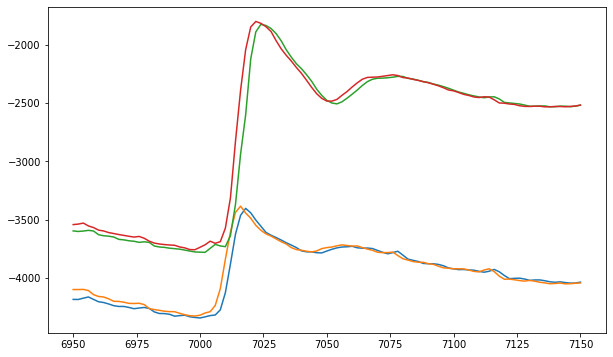

In [291]:
# lithium iron(II) phosphate

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'nexafs_Fe_iron' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


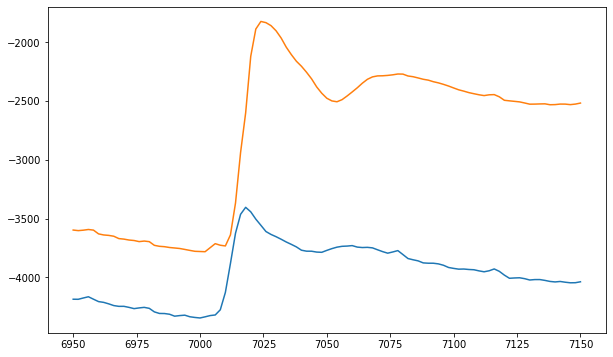

In [297]:
# lithium iron(II) phosphate

nexafs_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'nexafs_Fe_iron' in f and 'forward' in f)

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [ ]:
# new bar
    # AgB
    # mostafa's caso4-scaled xle membrane

/mnt/data531/20240524ML_commissioning/saxs_ML_AgB_7000.0eV_5sec_1161.1mV.tif 
/mnt/data531/20240524ML_commissioning/waxs_ML_AgB_7000.0eV_5sec_1161.1mV.tif 


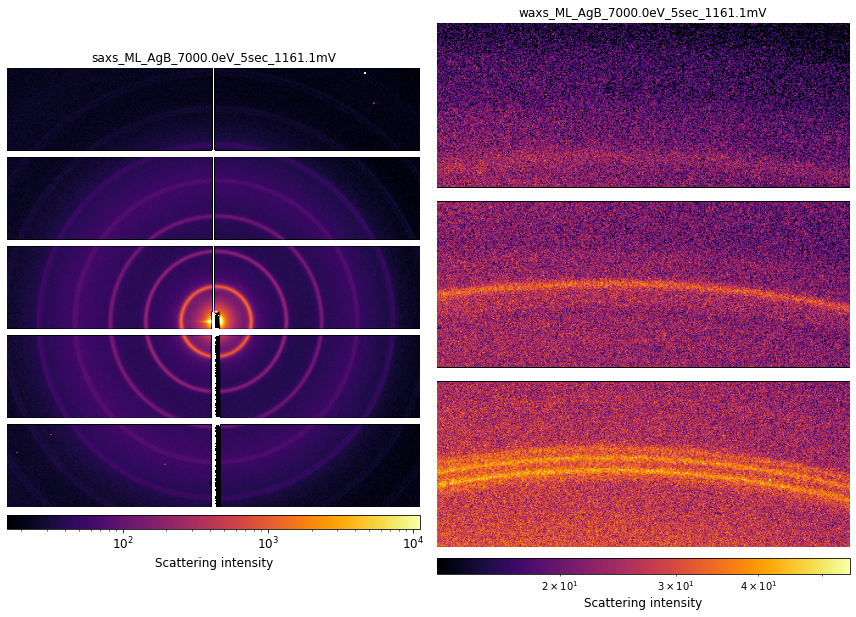

In [427]:
# saxs and waxs workflow

#energy_eV(epics.caget('bl531_xps1:mono_angle_deg'))
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(7000))

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
sample = 'AgB'
save_dir = '20240524ML_commissioning'

# input exposure times (seconds)
aqtime_saxs = 5
aqtime_waxs = 5
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

# additional file string info
save_path = f'/mnt/data531/{save_dir}'
os.makedirs(save_path, exist_ok=True)
energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

# saxs single image acquisition
epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV')
epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(aqtime_saxs * 2)
last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
print(last_filename_saxs)

# waxs single image acquisition
epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV')
epics.caput('pilatus300k:cam1:Acquire',1)
time_sleep(aqtime_waxs * 2)
last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
print(last_filename_waxs)


# display 2d images
fig, ax = plt.subplots(1, 2, figsize=(12, 10))
#saxs
image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
ax[0].axis('off')
ax[0].set_title(os.path.basename(last_filename_saxs).split('.tif')[0], size=12)
ax_divider0 = make_axes_locatable(ax[0])
cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
cax0.set_xlabel('Scattering intensity', size=12)
cax0.xaxis.set_label_position('bottom')
cax0.xaxis.tick_bottom()
cax0.xaxis.set_tick_params(labelsize=12)
#waxs
image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
ax[1].axis('off')
ax[1].set_title(os.path.basename(last_filename_waxs).split('.tif')[0], size=12)
ax_divider1 = make_axes_locatable(ax[1])
cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
cax1.set_xlabel('Scattering intensity', size=12)
cax1.xaxis.set_label_position('bottom')
cax1.xaxis.tick_bottom()
cax1.xaxis.set_tick_params(labelsize=12)

fig.tight_layout()



/mnt/data531/20240524ML_commissioning/saxs_ML_xlemembrane-caso4_8500.0eV_5sec_2863.0mV.tif 
/mnt/data531/20240524ML_commissioning/waxs_ML_xlemembrane-caso4_8500.0eV_5sec_2863.0mV.tif 


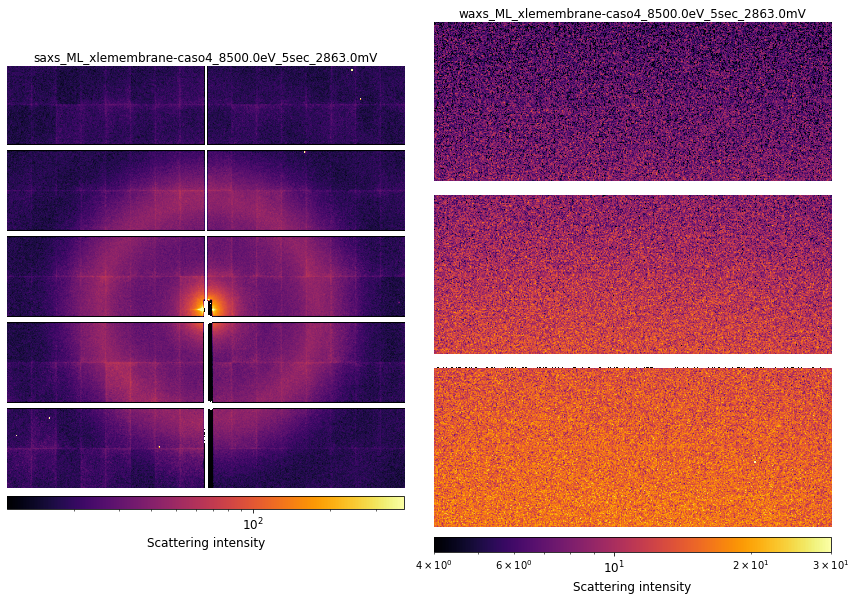

In [434]:
# saxs and waxs workflow

#energy_eV(epics.caget('bl531_xps1:mono_angle_deg'))
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8500))

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
sample = 'xlemembrane-caso4'
save_dir = '20240524ML_commissioning'

# input exposure times (seconds)
aqtime_saxs = 5
aqtime_waxs = 5
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

# additional file string info
save_path = f'/mnt/data531/{save_dir}'
os.makedirs(save_path, exist_ok=True)
energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

# saxs single image acquisition
epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV')
epics.caput('13PIL1:cam1:Acquire',1)
if aqtime_saxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_saxs * 2)
last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
print(last_filename_saxs)

# waxs single image acquisition
epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV')
epics.caput('pilatus300k:cam1:Acquire',1)
if aqtime_waxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_waxs * 2)
last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
print(last_filename_waxs)


# display 2d images
fig, ax = plt.subplots(1, 2, figsize=(12, 10))
#saxs
image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
ax[0].axis('off')
ax[0].set_title(os.path.basename(last_filename_saxs).split('.tif')[0], size=12)
ax_divider0 = make_axes_locatable(ax[0])
cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
cax0.set_xlabel('Scattering intensity', size=12)
cax0.xaxis.set_label_position('bottom')
cax0.xaxis.tick_bottom()
cax0.xaxis.set_tick_params(labelsize=12)
#waxs
image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
ax[1].axis('off')
ax[1].set_title(os.path.basename(last_filename_waxs).split('.tif')[0], size=12)
ax_divider1 = make_axes_locatable(ax[1])
cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
cax1.set_xlabel('Scattering intensity', size=12)
cax1.xaxis.set_label_position('bottom')
cax1.xaxis.tick_bottom()
cax1.xaxis.set_tick_params(labelsize=12)

fig.tight_layout()



In [ ]:
# new bar with kelvins samples

/mnt/data531/20240524ML_commissioning/kelvin/saxs_ML_kevlin-PAPPS-9_8000.0eV_10sec_2285.0mV_rep2.tif 
/mnt/data531/20240524ML_commissioning/kelvin/waxs_ML_kevlin-PAPPS-9_8000.0eV_10sec_2285.0mV_rep2.tif 


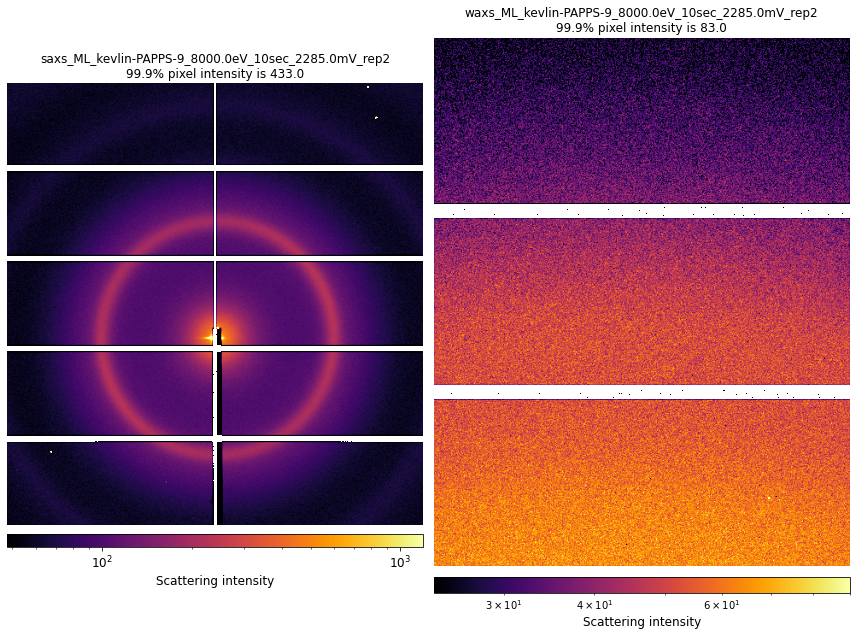

In [461]:
# saxs and waxs workflow

#energy_eV(epics.caget('bl531_xps1:mono_angle_deg'))
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8000))

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
sample = 'kelvin-PAPPS-4'
sample = 'kelvin-PAPPS-6'
sample = 'kevlin-PAPPS-9'
#sample = 'test'

save_dir = '20240524ML_commissioning/kelvin'

# input exposure times (seconds)
aqtime_saxs = 10
aqtime_waxs = 10
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

# additional file string info
save_path = f'/mnt/data531/{save_dir}'
os.makedirs(save_path, exist_ok=True)
energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

# saxs single image acquisition
epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV_rep2')
epics.caput('13PIL1:cam1:Acquire',1)
if aqtime_saxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_saxs * 2)
last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
print(last_filename_saxs)

# waxs single image acquisition
epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV_rep2')
epics.caput('pilatus300k:cam1:Acquire',1)
if aqtime_waxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_waxs * 2)
last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
print(last_filename_waxs)


# display 2d images
fig, ax = plt.subplots(1, 2, figsize=(12, 10))
#saxs
image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
ax[0].axis('off')

title = os.path.basename(last_filename_saxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_saxs_np, 99.9),2)
ax[0].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)



ax_divider0 = make_axes_locatable(ax[0])
cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
cax0.set_xlabel('Scattering intensity', size=12)
cax0.xaxis.set_label_position('bottom')
cax0.xaxis.tick_bottom()
cax0.xaxis.set_tick_params(labelsize=12)
#waxs
image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
ax[1].axis('off')
title = os.path.basename(last_filename_waxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_waxs_np, 99.9),2)
ax[1].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
ax_divider1 = make_axes_locatable(ax[1])
cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
cax1.set_xlabel('Scattering intensity', size=12)
cax1.xaxis.set_label_position('bottom')
cax1.xaxis.tick_bottom()
cax1.xaxis.set_tick_params(labelsize=12)

fig.tight_layout()



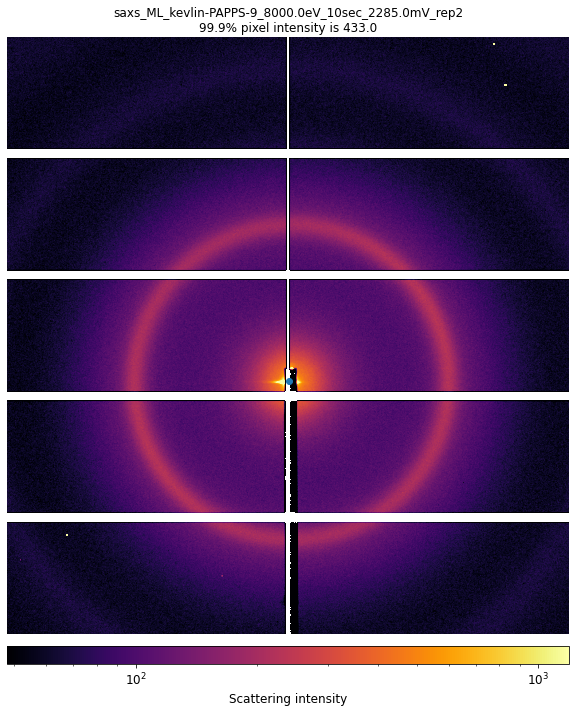

In [502]:
# quick beam centering



# display 2d images
fig, ax = plt.subplots(figsize=(12, 10))
#saxs
image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
im_saxs = ax.imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
ax.axis('off')
title = os.path.basename(last_filename_saxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_saxs_np, 99.9),2)
ax.set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)



ax_divider0 = make_axes_locatable(ax)
cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
cax0.set_xlabel('Scattering intensity', size=12)
cax0.xaxis.set_label_position('bottom')
cax0.xaxis.tick_bottom()
cax0.xaxis.set_tick_params(labelsize=12)

bc_x = 491
bc_y = 600

# display a scatter point to locate the beam position on the detector
ax.scatter(bc_x, bc_y )

fig.tight_layout()




In [496]:
kelvin_files = sorted(f for f in os.listdir(save_path) if 'test' not in f and 'rep1' in f and '8000' in f and 'saxs' in f)
kelvin_files

['saxs_ML_kelvin-PAPPS-4_8000.0eV_10sec_3612.0mV_rep1.tif',
 'saxs_ML_kelvin-PAPPS-6_8000.0eV_10sec_3403.0mV_rep1.tif',
 'saxs_ML_kevlin-PAPPS-9_8000.0eV_10sec_3053.0mV_rep1.tif']

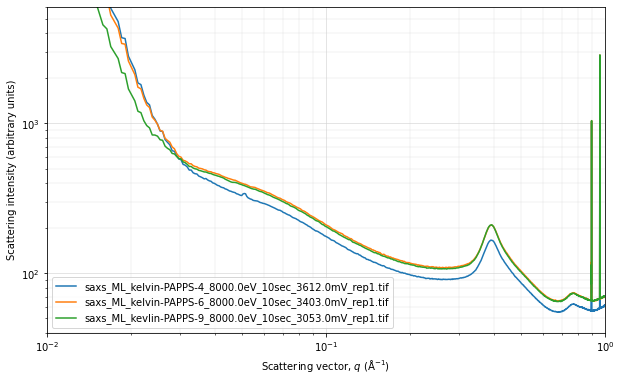

In [501]:
# plotting radially-integrated profiles for kelvins samples


az_range=[-180,180]
fig, ax = plt.subplots(figsize=(10,6))

# mrl measured 49 mm as sample-detector distance using a measuring tape
dist = 0.49
# rough beam center position using 2d image / scatter point above
poni1 = bc_y * 0.000172
poni2 = bc_x * 0.000172



mask_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/saxs_mask_mrl.edf'


rot1 = 0
rot2 = 0
rot3 = 0

for kelvin_file in kelvin_files[:]:
    
 
    # radial integration of a single pilatus saxs image

    filepath = os.path.join(save_path, kelvin_file)

    energy = 8000

    wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
    calibrant = pyFAI.calibrant.get_calibrant("AgBh")
    calibrant.wavelength = wavelength
    detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
    ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
    ai.maskfile = mask_path

    im_path = os.path.join(filepath)
    im_data = fabio.open(im_path)
    im_array = im_data.data
    im_array[im_array < 1] = 1
    im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
    qvector = im_reduced[0] / 10
    intensity = im_reduced[1] # / diode_value

    #log_intensity = np.log10(intensity)
    #log_intensity_offset = log_intensity - 1 * idx
    #intensity_offset = 10**(log_intensity_offset)
    #intensity = intensity_offset

    #qvector_list.append(qvector)
    #radint_list.append(intensity)
    #energy_list.append(energy)
    energy_rounded = round(energy, 0)
    ax.plot(qvector, intensity, label=kelvin_file)#, label=f'{energy_rounded} eV')
    ax.set_xscale('log')
    ax.set_yscale('log')    
    ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
    ax.set_ylabel('Scattering intensity (arbitrary units)')
    ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
    ax.legend()

    ax.set_xlim([0.01, 1])
    ax.set_ylim([40, 6000])
    #plt.show()

    #if flag_save:
    #    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
    #    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
    #    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
    #    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [ ]:
# saturday may 25

# bar contains (will require two or three pump downs)
    # kelvin   PAPPS-4
    # kelvin   PAPPS-6
    # kelvin   PAPPS-9
    # potassium permanganate
    # direct beam space

    # NEED AGB!!!!!

    

/mnt/data531/20240525ML_commissioning/saxs_ML_kevlin-PAPPS-9-pos2_8500.0eV_30sec_1616.0mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_kevlin-PAPPS-9-pos2_8500.0eV_30sec_1616.0mV.tif 


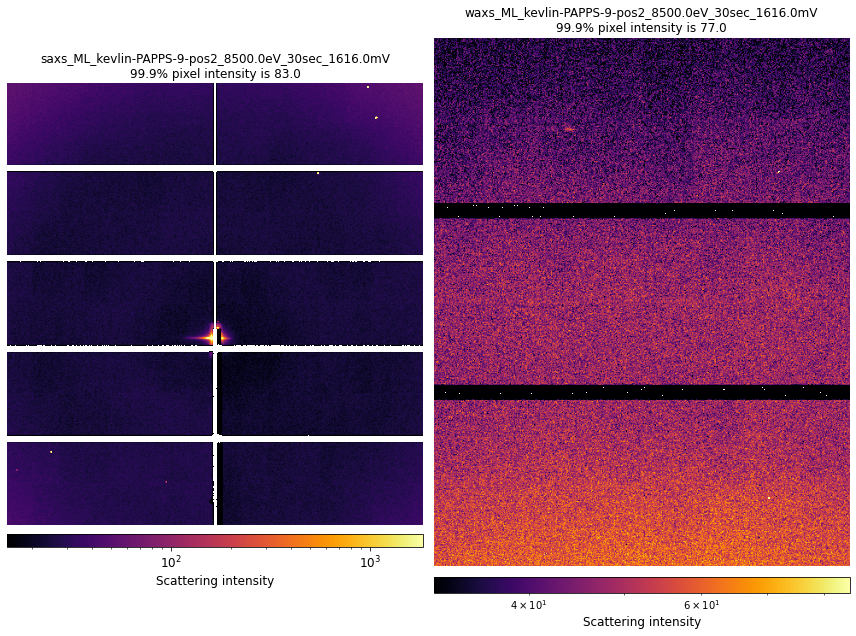

In [70]:
# saxs and waxs workflow

#energy_eV(epics.caget('bl531_xps1:mono_angle_deg'))


#epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8000))
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8500))

time_sleep(10)

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
#sample = 'kelvin-PAPPS-4-pos1'
#sample = 'kelvin-PAPPS-4-pos2'
#sample = 'kelvin-PAPPS-6-pos1'
#sample = 'kelvin-PAPPS-6-pos2'

#sample = 'kevlin-PAPPS-9-pos1'
sample = 'kevlin-PAPPS-9-pos2'
#sample = 'test'

save_dir = '20240525ML_commissioning'

# input exposure times (seconds)
aqtime_saxs = 30
aqtime_waxs = 30
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

# additional file string info
save_path = f'/mnt/data531/{save_dir}'
os.makedirs(save_path, exist_ok=True)
energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

# saxs single image acquisition
epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV')
epics.caput('13PIL1:cam1:Acquire',1)
if aqtime_saxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_saxs * 2)
last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
print(last_filename_saxs)

# waxs single image acquisition
epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV')
epics.caput('pilatus300k:cam1:Acquire',1)
if aqtime_waxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_waxs * 2)
last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
print(last_filename_waxs)


# display 2d images
fig, ax = plt.subplots(1, 2, figsize=(12, 10))
#saxs
image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
if np.percentile(im_saxs_np, 10) < 1:
    im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', vmin=np.percentile(im_saxs_np, 10), vmax=np.percentile(im_saxs_np, 99.9), aspect='equal')
else:
    im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
ax[0].axis('off')
title = os.path.basename(last_filename_saxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_saxs_np, 99.9),2)
ax[0].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
ax_divider0 = make_axes_locatable(ax[0])
cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
cax0.set_xlabel('Scattering intensity', size=12)
cax0.xaxis.set_label_position('bottom')
cax0.xaxis.tick_bottom()
cax0.xaxis.set_tick_params(labelsize=12)
#waxs
image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
if np.percentile(im_waxs_np, 10) < 1:
    im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', vmin=np.percentile(im_waxs_np, 10), vmax=np.percentile(im_waxs_np, 99.9), aspect='equal')
else:
    im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
ax[1].axis('off')
title = os.path.basename(last_filename_waxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_waxs_np, 99.9),2)
ax[1].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
ax_divider1 = make_axes_locatable(ax[1])
cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
cax1.set_xlabel('Scattering intensity', size=12)
cax1.xaxis.set_label_position('bottom')
cax1.xaxis.tick_bottom()
cax1.xaxis.set_tick_params(labelsize=12)

fig.tight_layout()



In [71]:
image_files = sorted(f for f in os.listdir(save_path) if 'PAPPS' in f)
image_files

['saxs_ML_kelvin-PAPPS-4-pos1_8000.0eV_30sec_1822.5mV.tif',
 'saxs_ML_kelvin-PAPPS-4-pos1_8500.0eV_30sec_1711.7mV.tif',
 'saxs_ML_kelvin-PAPPS-4-pos2_8000.0eV_30sec_3154.0mV.tif',
 'saxs_ML_kelvin-PAPPS-4-pos2_8500.0eV_30sec_1937.3mV.tif',
 'saxs_ML_kelvin-PAPPS-6-pos1_8000.0eV_30sec_3956.0mV.tif',
 'saxs_ML_kelvin-PAPPS-6-pos1_8500.0eV_30sec_2140.0mV.tif',
 'saxs_ML_kelvin-PAPPS-6-pos2_8000.0eV_30sec_3139.0mV.tif',
 'saxs_ML_kelvin-PAPPS-6-pos2_8500.0eV_30sec_1907.1mV.tif',
 'saxs_ML_kevlin-PAPPS-9-pos1_8000.0eV_30sec_1431.0mV.tif',
 'saxs_ML_kevlin-PAPPS-9-pos1_8500.0eV_30sec_1349.2mV.tif',
 'saxs_ML_kevlin-PAPPS-9-pos2_8000.0eV_30sec_2504.0mV.tif',
 'saxs_ML_kevlin-PAPPS-9-pos2_8500.0eV_30sec_1616.0mV.tif',
 'waxs_ML_kelvin-PAPPS-4-pos1_8000.0eV_30sec_3101.0mV.tif',
 'waxs_ML_kelvin-PAPPS-4-pos1_8500.0eV_30sec_1711.7mV.tif',
 'waxs_ML_kelvin-PAPPS-4-pos2_8000.0eV_30sec_3154.0mV.tif',
 'waxs_ML_kelvin-PAPPS-4-pos2_8500.0eV_30sec_1937.3mV.tif',
 'waxs_ML_kelvin-PAPPS-6-pos1_8000.0eV_3

AssertionError: 

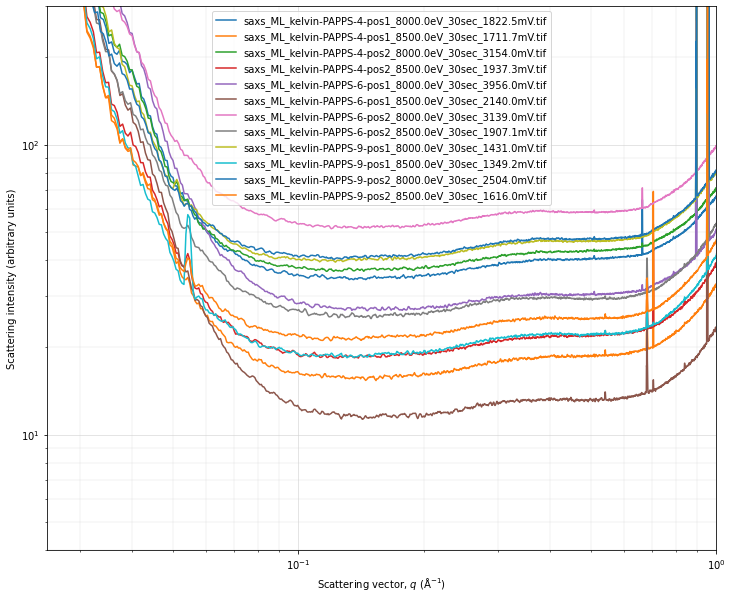

In [72]:
# plotting radially-integrated profiles for kelvins samples


az_range=[-180,180]
fig, ax = plt.subplots(figsize=(12,10))

# mrl measured 49 mm as sample-detector distance using a measuring tape
dist = 0.49

bc_x = 491
bc_y = 600


# rough beam center position using 2d image / scatter point above
poni1 = bc_y * 0.000172
poni2 = bc_x * 0.000172



mask_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/saxs_mask_mrl.edf'


rot1 = 0
rot2 = 0
rot3 = 0

for file in image_files[:]:
    
 
    # radial integration of a single pilatus saxs image

    filepath = os.path.join(save_path, file)

    energy = float(file[file.find('eV') - 6 : file.find('eV')])

    wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
    calibrant = pyFAI.calibrant.get_calibrant("AgBh")
    calibrant.wavelength = wavelength
    detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
    ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
    ai.maskfile = mask_path

    im_path = os.path.join(filepath)
    im_data = fabio.open(im_path)
    im_array = im_data.data
    im_array[im_array < 1] = 1
    im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
    qvector = im_reduced[0] / 10
    intensity = im_reduced[1] # / diode_value

    #log_intensity = np.log10(intensity)
    #log_intensity_offset = log_intensity - 1 * idx
    #intensity_offset = 10**(log_intensity_offset)
    #intensity = intensity_offset

    #qvector_list.append(qvector)
    #radint_list.append(intensity)
    #energy_list.append(energy)
    energy_rounded = round(energy, 0)
    ax.plot(qvector, intensity, label=file)#, label=f'{energy_rounded} eV')
    ax.set_xscale('log')
    ax.set_yscale('log')    
    ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
    ax.set_ylabel('Scattering intensity (arbitrary units)')
    ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
    ax.legend()

    ax.set_xlim([0.025, 1])
    ax.set_ylim([4, 300])

    #if flag_save:
    #    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
    #    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
    #    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
    #    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [75]:
input_energies = np.linspace(6450, 6600, 76)  


file_name = 'nexafs_Mn_test'
np.savetxt(f'/mnt/data531/20240525ML_commissioning/{file_name}.txt', np.vstack((input_energies)).T)

In [85]:
# nexafs - lets find the manganese k-edge 


input_energies = np.linspace(6380, 6580, 201)  



time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 

file_name = 'nexafs_Mn_KMnO4_forward'
np.savetxt(f'/mnt/data531/20240525ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)



input_energies = np.linspace(6580, 6380, 201)  

time_sleep_variable = 1
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')

    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3

file_name = 'nexafs_Mn_KMnO4_reverse'
np.savetxt(f'/mnt/data531/20240525ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)




100%|██████████| 201/201 [13:27<00:00,  4.02s/it]


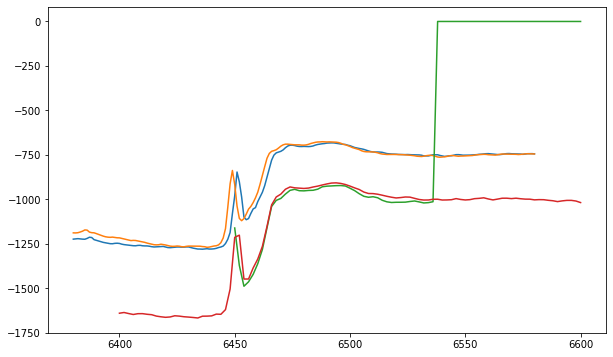

In [86]:
# potassium permanganate reference powder (Mn K-edge)

nexafs_path = '/mnt/data531/20240525ML_commissioning/'

nexafs_files = sorted(f for f in os.listdir(nexafs_path) if 'nexafs_Mn' in f )

fig, ax = plt.subplots(figsize=(10,6))

for nexafs_file in nexafs_files:
    data = np.loadtxt(os.path.join(nexafs_path, nexafs_file))
    ax.plot(data[:,0], data[:, 2])


In [ ]:
# final pump down has a direct beam space and an AgB sample

/mnt/data531/20240525ML_commissioning/saxs_ML_directbeam_8000.0eV_30sec_2030.0mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_directbeam_8000.0eV_30sec_2030.0mV.tif 


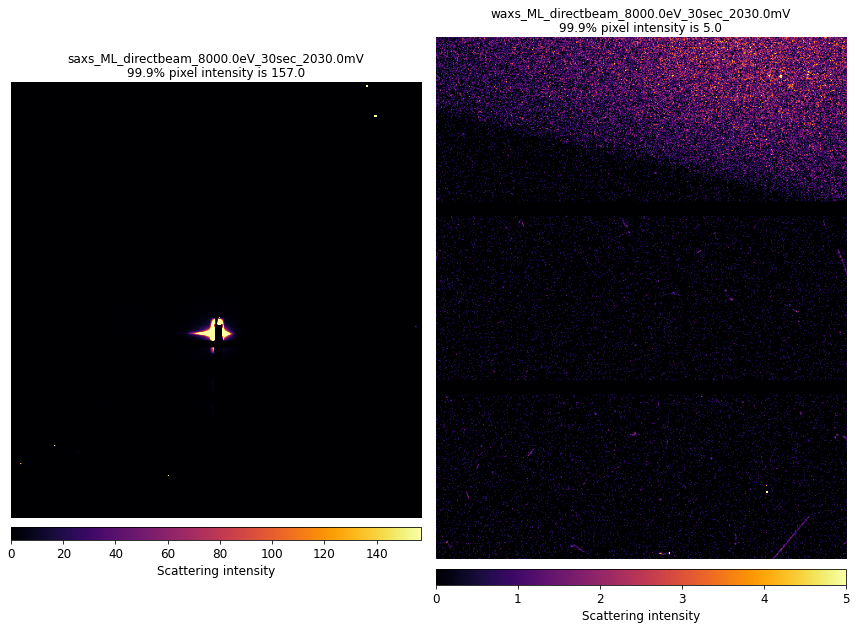

In [97]:
# first, get background scattering images on direct beam to subtract from kelvin's free standing membranes


epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8000))
#epics.caput('bl531_xps1:mono_angle_deg', mono_deg(8500))

#time_sleep(10)

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
sample = 'directbeam'
#sample = 'test'

save_dir = '20240525ML_commissioning'

# input exposure times (seconds)
aqtime_saxs = 30
aqtime_waxs = 30
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

# additional file string info
save_path = f'/mnt/data531/{save_dir}'
os.makedirs(save_path, exist_ok=True)
energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

# saxs single image acquisition
epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV')
epics.caput('13PIL1:cam1:Acquire',1)
if aqtime_saxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_saxs * 2)
last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
print(last_filename_saxs)

# waxs single image acquisition
epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV')
epics.caput('pilatus300k:cam1:Acquire',1)
if aqtime_waxs < 2.5:
    time_sleep(5)
else:
    time_sleep(aqtime_waxs * 2)
last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
print(last_filename_waxs)


# display 2d images
fig, ax = plt.subplots(1, 2, figsize=(12, 10))
#saxs
image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
if np.percentile(im_saxs_np, 10) < 1:
    im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', vmin=np.percentile(im_saxs_np, 10), vmax=np.percentile(im_saxs_np, 99.9), aspect='equal')
else:
    im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
ax[0].axis('off')
title = os.path.basename(last_filename_saxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_saxs_np, 99.9),2)
ax[0].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
ax_divider0 = make_axes_locatable(ax[0])
cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
cax0.set_xlabel('Scattering intensity', size=12)
cax0.xaxis.set_label_position('bottom')
cax0.xaxis.tick_bottom()
cax0.xaxis.set_tick_params(labelsize=12)
#waxs
image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
if np.percentile(im_waxs_np, 10) < 1:
    im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', vmin=np.percentile(im_waxs_np, 10), vmax=np.percentile(im_waxs_np, 99.9), aspect='equal')
else:
    im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
ax[1].axis('off')
title = os.path.basename(last_filename_waxs).split('.tif')[0]
intensity_99percent = np.round(np.percentile(im_waxs_np, 99.9),2)
ax[1].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
ax_divider1 = make_axes_locatable(ax[1])
cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
cax1.set_xlabel('Scattering intensity', size=12)
cax1.xaxis.set_label_position('bottom')
cax1.xaxis.tick_bottom()
cax1.xaxis.set_tick_params(labelsize=12)

fig.tight_layout()



In [94]:
image_files = sorted(f for f in os.listdir(save_path) if 'directbeam' in f)
image_files

['saxs_ML_directbeam_8500.0eV_30sec_1927.2mV.tif',
 'waxs_ML_directbeam_8500.0eV_30sec_1927.2mV.tif']

AssertionError: 

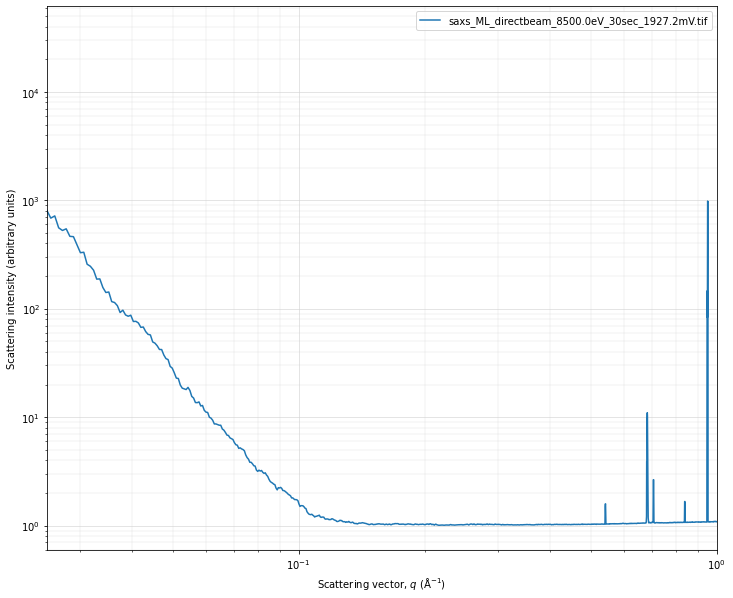

In [96]:
# plotting radially-integrated profiles 


az_range=[-180,180]
fig, ax = plt.subplots(figsize=(12,10))

# mrl measured 49 mm as sample-detector distance using a measuring tape
dist = 0.49

bc_x = 491
bc_y = 600


# rough beam center position using 2d image / scatter point above
poni1 = bc_y * 0.000172
poni2 = bc_x * 0.000172



mask_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/saxs_mask_mrl.edf'


rot1 = 0
rot2 = 0
rot3 = 0

for file in image_files[:]:
    
 
    # radial integration of a single pilatus saxs image

    filepath = os.path.join(save_path, file)

    energy = float(file[file.find('eV') - 6 : file.find('eV')])

    wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
    calibrant = pyFAI.calibrant.get_calibrant("AgBh")
    calibrant.wavelength = wavelength
    detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
    ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
    ai.maskfile = mask_path

    im_path = os.path.join(filepath)
    im_data = fabio.open(im_path)
    im_array = im_data.data
    im_array[im_array < 1] = 1
    im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
    qvector = im_reduced[0] / 10
    intensity = im_reduced[1] # / diode_value

    #log_intensity = np.log10(intensity)
    #log_intensity_offset = log_intensity - 1 * idx
    #intensity_offset = 10**(log_intensity_offset)
    #intensity = intensity_offset

    #qvector_list.append(qvector)
    #radint_list.append(intensity)
    #energy_list.append(energy)
    energy_rounded = round(energy, 0)
    ax.plot(qvector, intensity, label=file)#, label=f'{energy_rounded} eV')
    ax.set_xscale('log')
    ax.set_yscale('log')    
    ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
    ax.set_ylabel('Scattering intensity (arbitrary units)')
    ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
    ax.legend()

    ax.set_xlim([0.025, 1])
   # ax.set_ylim([4, 300])

    #if flag_save:
    #    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
    #    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
    #    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
    #    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5000.0eV_10sec_304.8mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5000.0eV_10sec_304.8mV.tif 
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5250.0eV_10sec_490.4mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5250.0eV_10sec_490.4mV.tif 
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5500.0eV_10sec_1052.0mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5500.0eV_10sec_1052.0mV.tif 
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5750.0eV_10sec_2682.0mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5750.0eV_10sec_2682.0mV.tif 
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_6000.0eV_10sec_4057.0mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_6000.0eV_10sec_4057.0mV.tif 
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_6250.0eV_10sec_5196.0mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_6250.0eV_10sec_5196.0mV.tif 
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_6500.0

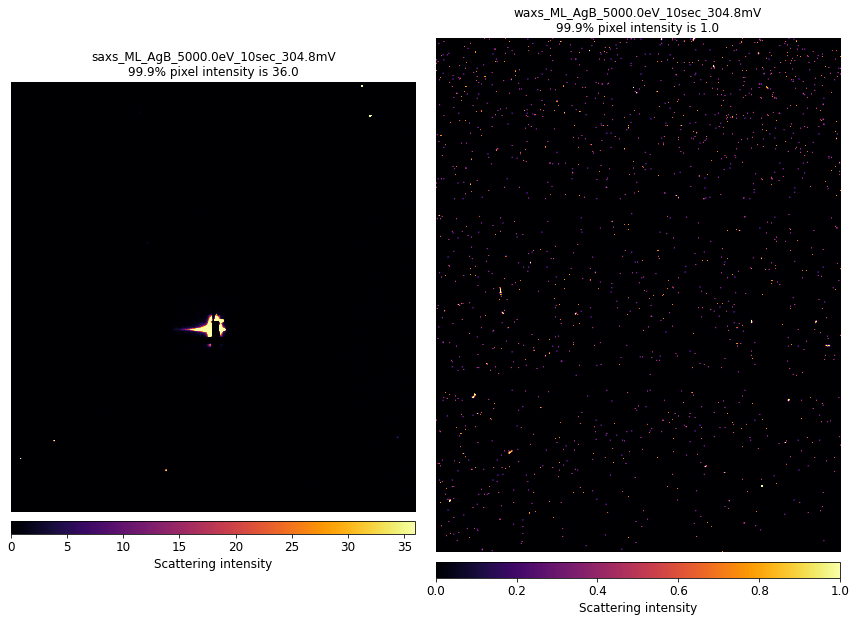

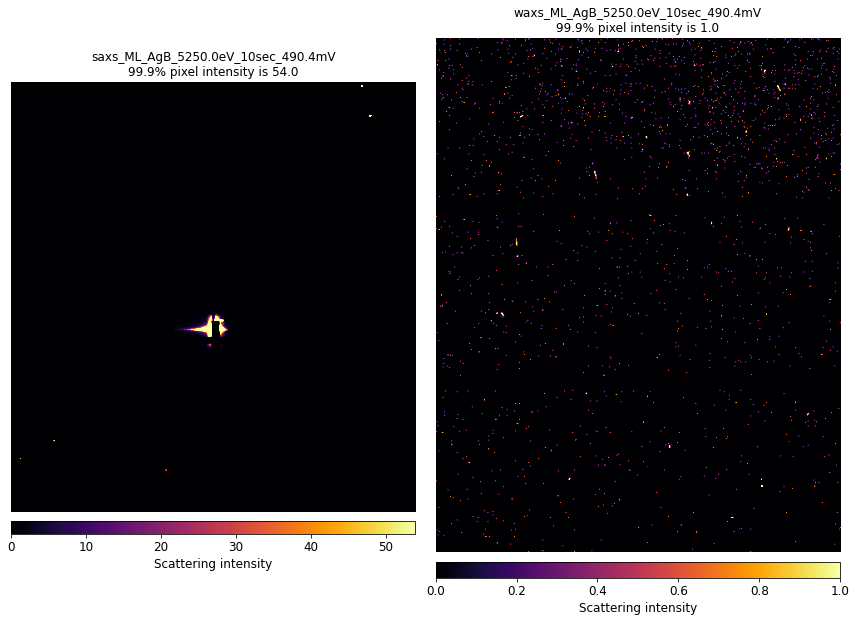

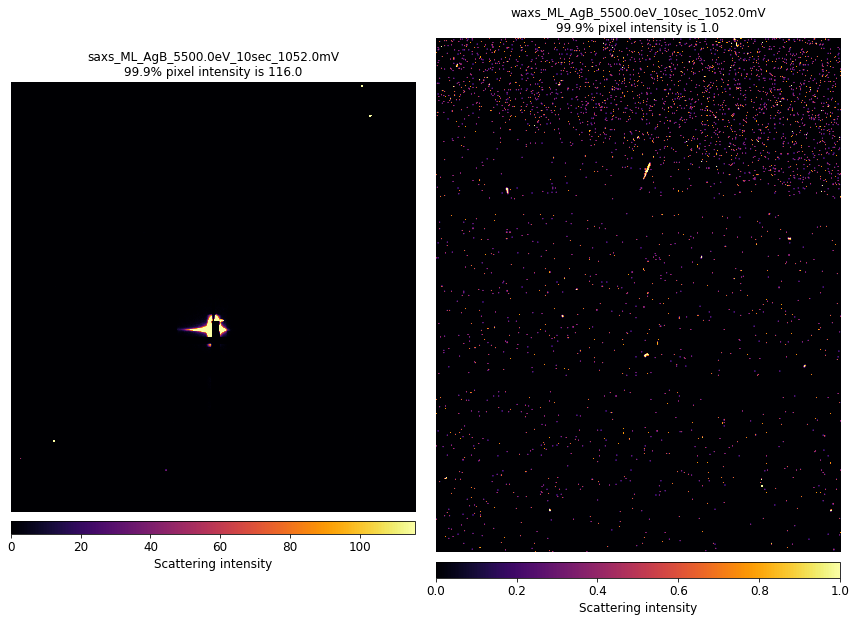

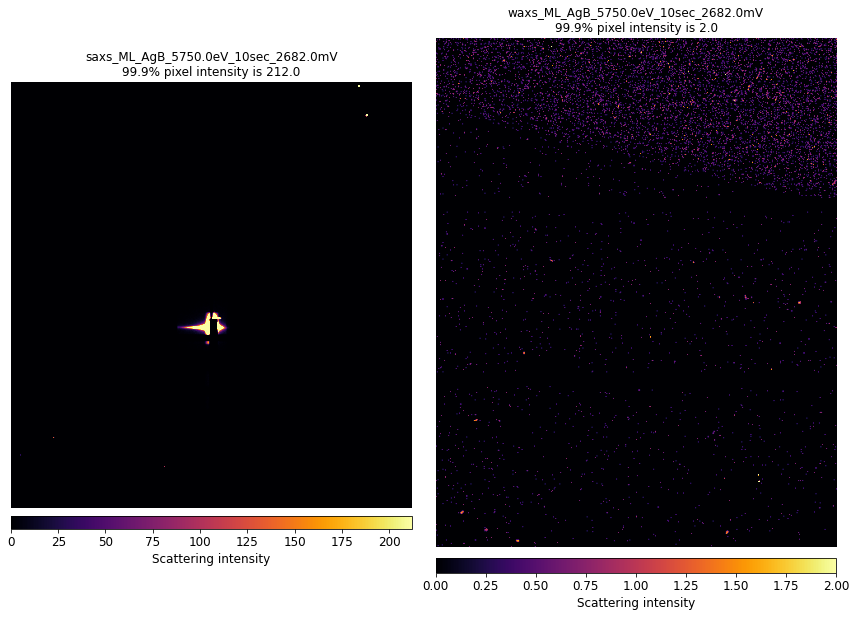

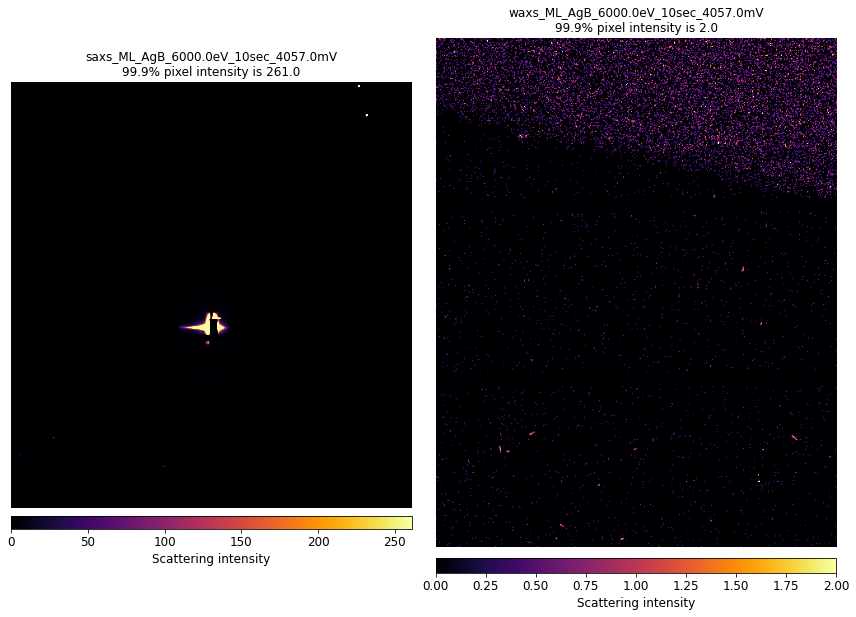

...

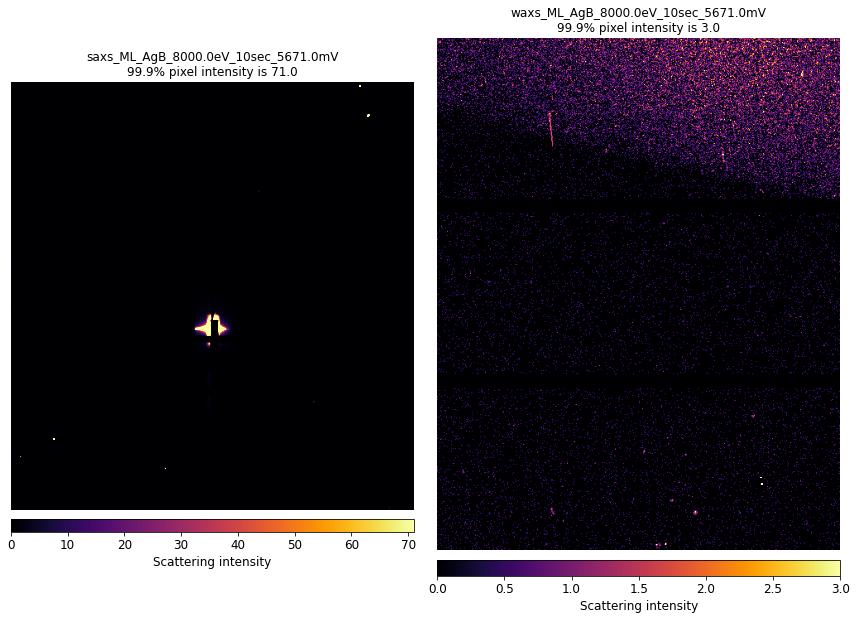

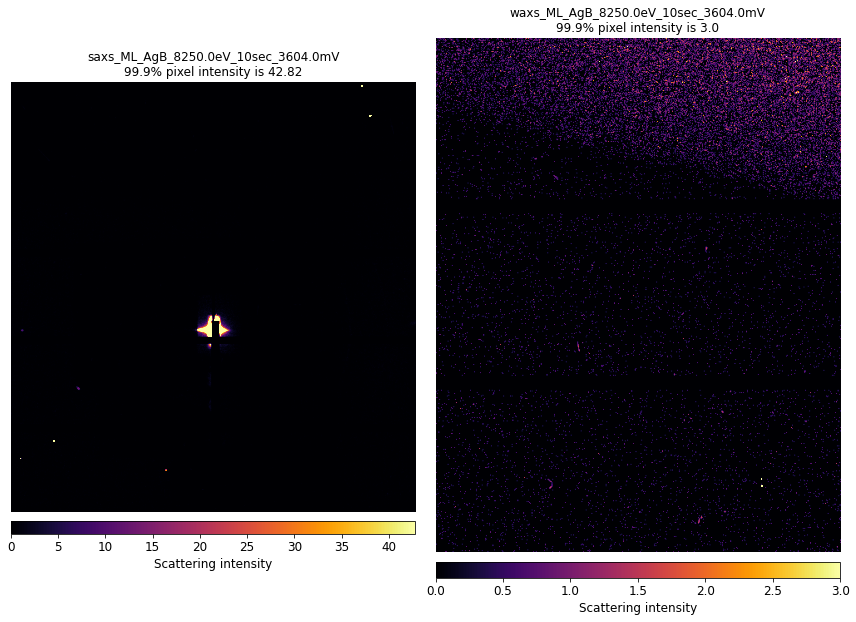

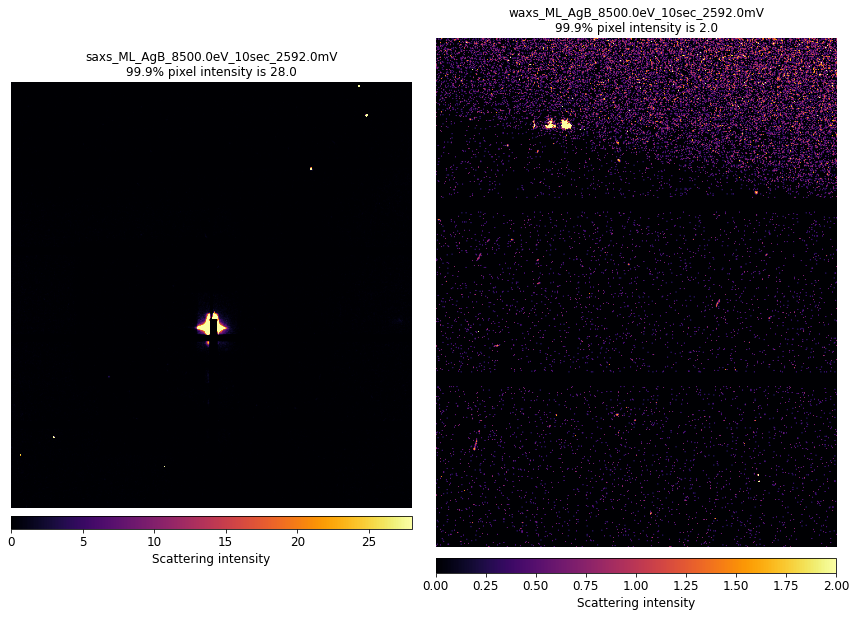

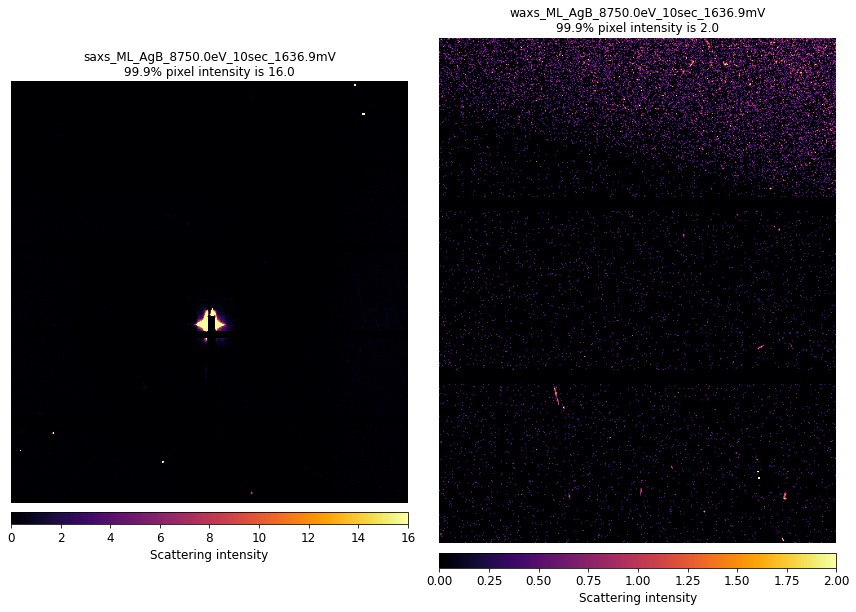

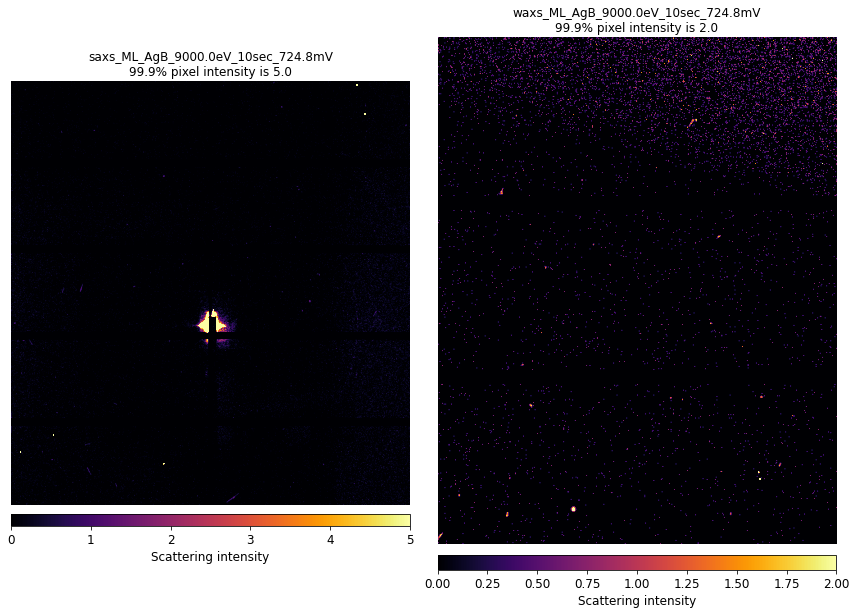

In [107]:
# AgB - energy scan to collect SAXS and WAXS across broad range

# thorlabs stage kept moving (forgot to turn it off when at position) so these are all direct beams

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
sample = 'AgB'
#sample = 'test'

save_dir = '20240525ML_commissioning'

# input exposure times (seconds)
aqtime_saxs = 10
aqtime_waxs = 10
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

energy_list = [5000, 5250, 5500, 5750, 6000, 6250, 6500, 6750, 7000, 7250, 7500, 7750, 8000, 8250, 8500, 8750, 9000]

for energy in energy_list:

    epics.caput('bl531_xps1:mono_angle_deg', mono_deg(energy))
    time_sleep(5)

    # additional file string info
    save_path = f'/mnt/data531/{save_dir}'
    os.makedirs(save_path, exist_ok=True)
    energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
    beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

    # saxs single image acquisition
    epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
    epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
    epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV')
    epics.caput('13PIL1:cam1:Acquire',1)
    if aqtime_saxs < 2.5:
        time_sleep(5)
    else:
        time_sleep(aqtime_saxs * 2)
    last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
    last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
    print(last_filename_saxs)

    # waxs single image acquisition
    epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
    epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
    epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV')
    epics.caput('pilatus300k:cam1:Acquire',1)
    if aqtime_waxs < 2.5:
        time_sleep(5)
    else:
        time_sleep(aqtime_waxs * 2)
    last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
    last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
    print(last_filename_waxs)


    # display 2d images
    fig, ax = plt.subplots(1, 2, figsize=(12, 10))
    #saxs
    image_saxs_data = Image.open(last_filename_saxs[:-1])
    im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
    if np.percentile(im_saxs_np, 10) < 1:
        im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', vmin=np.percentile(im_saxs_np, 10), vmax=np.percentile(im_saxs_np, 99.9), aspect='equal')
    else:
        im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
    ax[0].axis('off')
    title = os.path.basename(last_filename_saxs).split('.tif')[0]
    intensity_99percent = np.round(np.percentile(im_saxs_np, 99.9),2)
    ax[0].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
    ax_divider0 = make_axes_locatable(ax[0])
    cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
    plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
    cax0.set_xlabel('Scattering intensity', size=12)
    cax0.xaxis.set_label_position('bottom')
    cax0.xaxis.tick_bottom()
    cax0.xaxis.set_tick_params(labelsize=12)
    #waxs
    image_waxs_data = Image.open(last_filename_waxs[:-1])
    im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
    if np.percentile(im_waxs_np, 10) < 1:
        im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', vmin=np.percentile(im_waxs_np, 10), vmax=np.percentile(im_waxs_np, 99.9), aspect='equal')
    else:
        im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
    ax[1].axis('off')
    title = os.path.basename(last_filename_waxs).split('.tif')[0]
    intensity_99percent = np.round(np.percentile(im_waxs_np, 99.9),2)
    ax[1].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
    ax_divider1 = make_axes_locatable(ax[1])
    cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
    plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
    cax1.set_xlabel('Scattering intensity', size=12)
    cax1.xaxis.set_label_position('bottom')
    cax1.xaxis.tick_bottom()
    cax1.xaxis.set_tick_params(labelsize=12)

    fig.tight_layout()




In [108]:
image_files = sorted(f for f in os.listdir(save_path) if 'AgB' in f)
image_files

['saxs_ML_AgB_5000.0eV_10sec_304.8mV.tif',
 'saxs_ML_AgB_5250.0eV_10sec_490.4mV.tif',
 'saxs_ML_AgB_5500.0eV_10sec_1052.0mV.tif',
 'saxs_ML_AgB_5750.0eV_10sec_2682.0mV.tif',
 'saxs_ML_AgB_6000.0eV_10sec_4057.0mV.tif',
 'saxs_ML_AgB_6250.0eV_10sec_5196.0mV.tif',
 'saxs_ML_AgB_6500.0eV_10sec_5823.0mV.tif',
 'saxs_ML_AgB_6750.0eV_10sec_6588.0mV.tif',
 'saxs_ML_AgB_7000.0eV_10sec_7182.0mV.tif',
 'saxs_ML_AgB_7250.0eV_10sec_7535.0mV.tif',
 'saxs_ML_AgB_7500.0eV_10sec_7787.0mV.tif',
 'saxs_ML_AgB_7750.0eV_10sec_7993.0mV.tif',
 'saxs_ML_AgB_8000.0eV_10sec_5671.0mV.tif',
 'saxs_ML_AgB_8250.0eV_10sec_3604.0mV.tif',
 'saxs_ML_AgB_8500.0eV_10sec_2592.0mV.tif',
 'saxs_ML_AgB_8750.0eV_10sec_1636.9mV.tif',
 'saxs_ML_AgB_9000.0eV_10sec_724.8mV.tif',
 'waxs_ML_AgB_5000.0eV_10sec_304.8mV.tif',
 'waxs_ML_AgB_5250.0eV_10sec_490.4mV.tif',
 'waxs_ML_AgB_5500.0eV_10sec_1052.0mV.tif',
 'waxs_ML_AgB_5750.0eV_10sec_2682.0mV.tif',
 'waxs_ML_AgB_6000.0eV_10sec_4057.0mV.tif',
 'waxs_ML_AgB_6250.0eV_10sec_5196.0mV

AssertionError: 

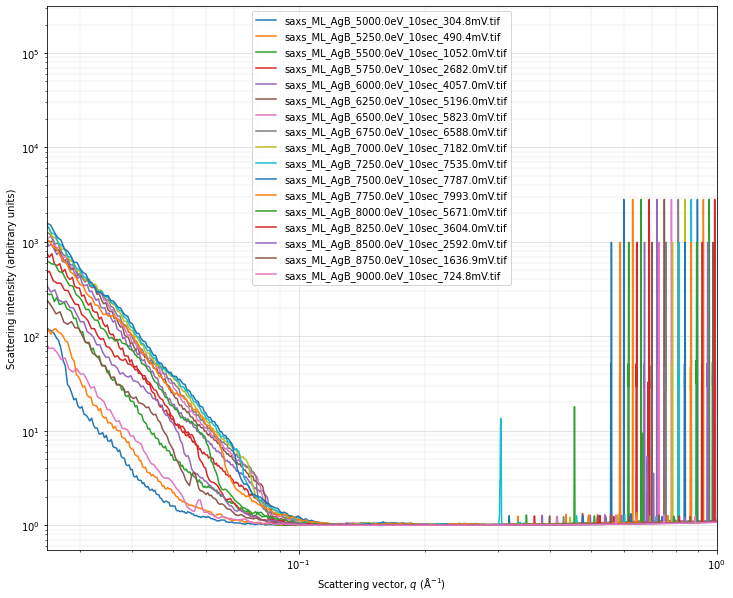

In [109]:
# plotting radially-integrated profiles 


az_range=[-180,180]
fig, ax = plt.subplots(figsize=(12,10))

# mrl measured 49 mm as sample-detector distance using a measuring tape
dist = 0.49

bc_x = 491
bc_y = 600


# rough beam center position using 2d image / scatter point above
poni1 = bc_y * 0.000172
poni2 = bc_x * 0.000172



mask_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/saxs_mask_mrl.edf'


rot1 = 0
rot2 = 0
rot3 = 0

for file in image_files[:]:
    
 
    # radial integration of a single pilatus saxs image

    filepath = os.path.join(save_path, file)

    energy = float(file[file.find('eV') - 6 : file.find('eV')])

    wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
    calibrant = pyFAI.calibrant.get_calibrant("AgBh")
    calibrant.wavelength = wavelength
    detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
    ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
    ai.maskfile = mask_path

    im_path = os.path.join(filepath)
    im_data = fabio.open(im_path)
    im_array = im_data.data
    im_array[im_array < 1] = 1
    im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
    qvector = im_reduced[0] / 10
    intensity = im_reduced[1] # / diode_value

    #log_intensity = np.log10(intensity)
    #log_intensity_offset = log_intensity - 1 * idx
    #intensity_offset = 10**(log_intensity_offset)
    #intensity = intensity_offset

    #qvector_list.append(qvector)
    #radint_list.append(intensity)
    #energy_list.append(energy)
    energy_rounded = round(energy, 0)
    ax.plot(qvector, intensity, label=file)#, label=f'{energy_rounded} eV')
    ax.set_xscale('log')
    ax.set_yscale('log')    
    ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
    ax.set_ylabel('Scattering intensity (arbitrary units)')
    ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
    ax.legend()

    ax.set_xlim([0.025, 1])
   # ax.set_ylim([4, 300])

    #if flag_save:
    #    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
    #    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
    #    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
    #    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [110]:
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(5000))


1

/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5000.0eV_10sec_106.52mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5000.0eV_10sec_106.52mV.tif 
99.9% intensity on saxs detector at 5000.0 is 17.0
99.9% intensity on waxs detector at 5000.0 is 3.0
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5250.0eV_10sec_124.76mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5250.0eV_10sec_124.76mV.tif 
99.9% intensity on saxs detector at 5250.0 is 44.0
99.9% intensity on waxs detector at 5250.0 is 5.0
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5500.0eV_10sec_160.92mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5500.0eV_10sec_160.92mV.tif 
99.9% intensity on saxs detector at 5500.0 is 89.0
99.9% intensity on waxs detector at 5500.0 is 9.0
/mnt/data531/20240525ML_commissioning/saxs_ML_AgB_5750.0eV_10sec_336.9mV.tif 
/mnt/data531/20240525ML_commissioning/waxs_ML_AgB_5750.0eV_10sec_336.9mV.tif 
99.9% intensity on saxs detector at 5750.0 is 335.0
99.9% intensity

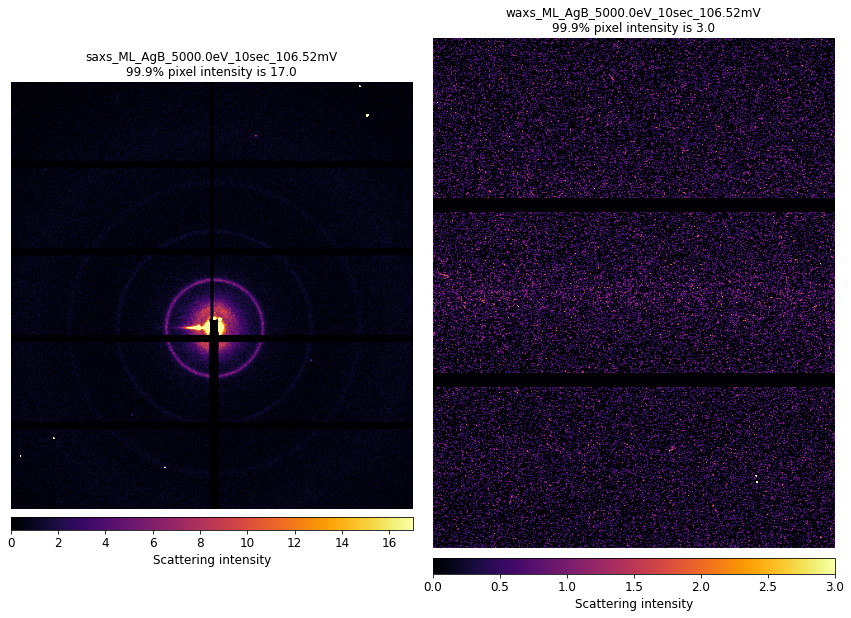

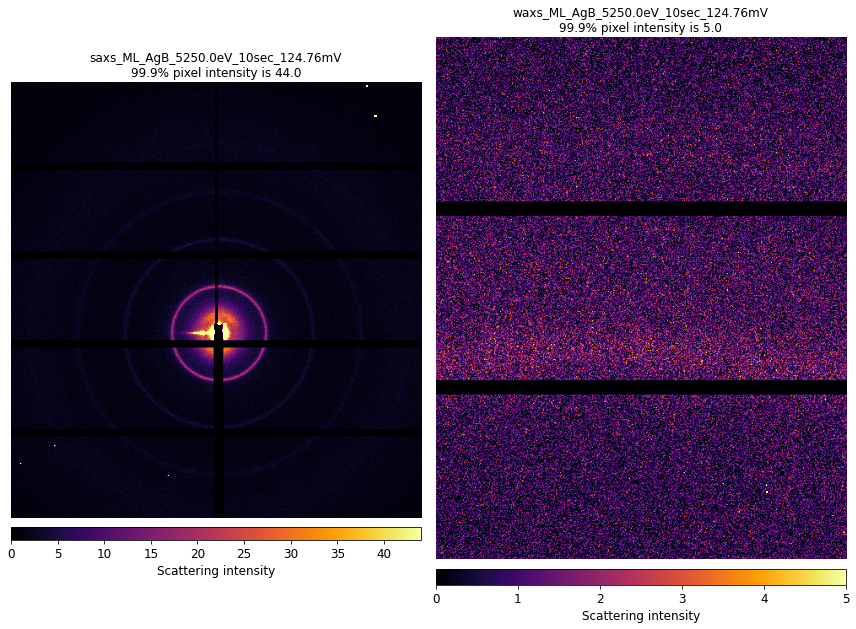

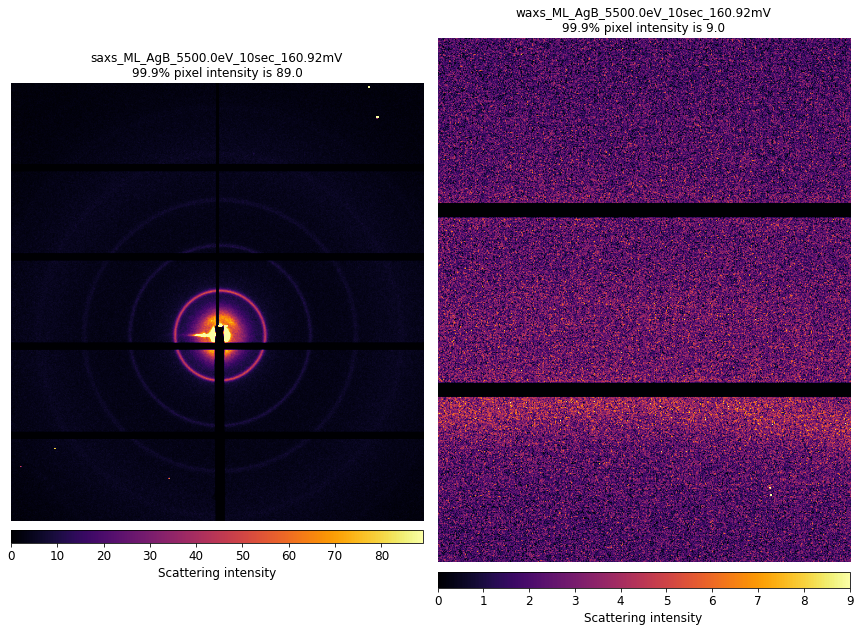

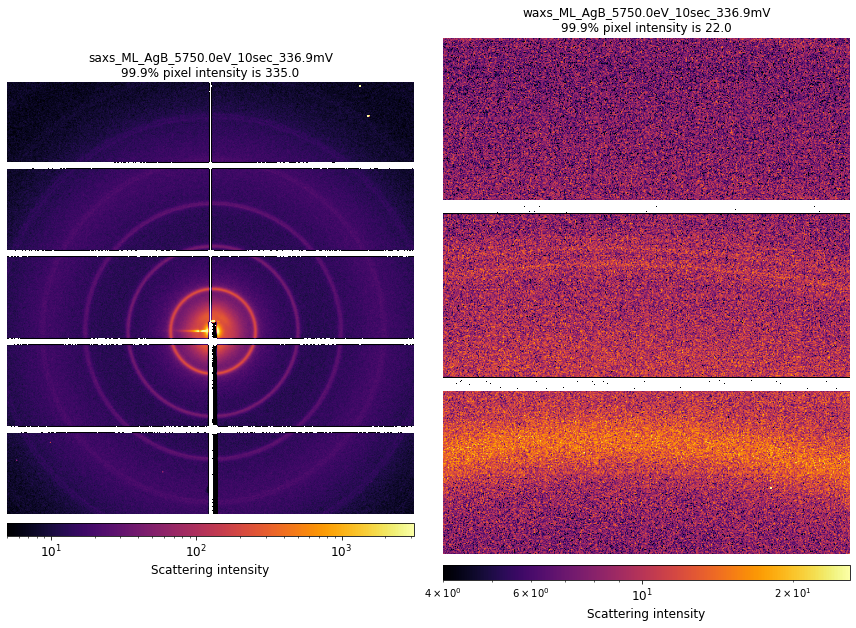

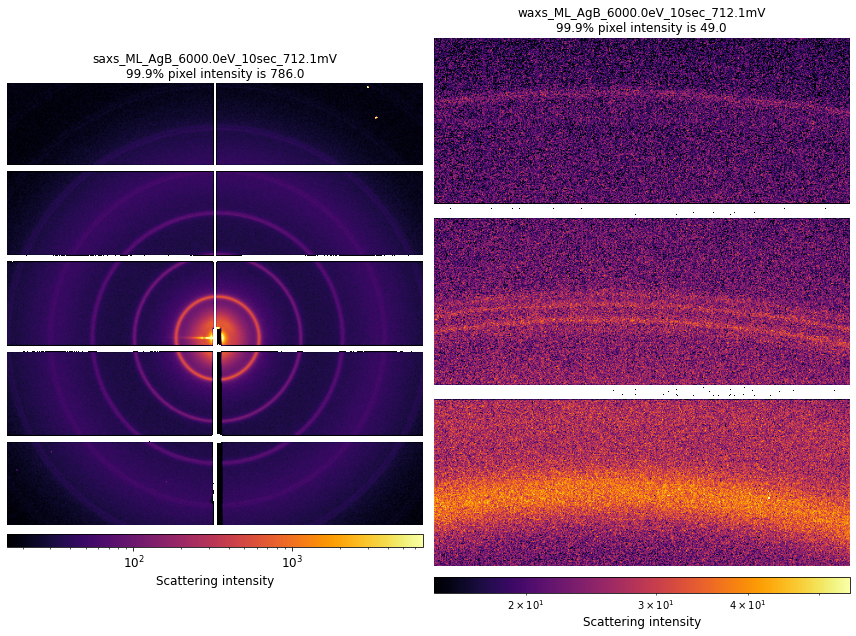

...

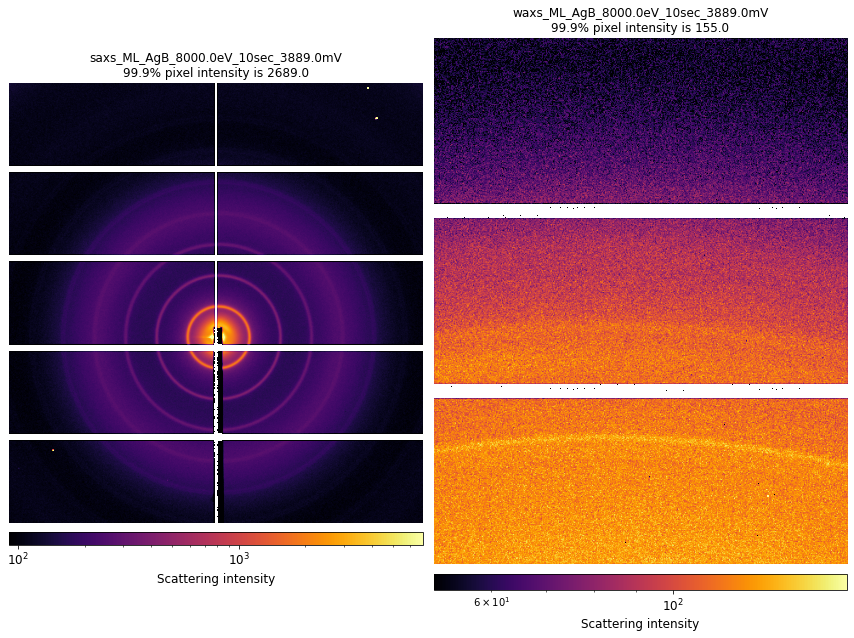

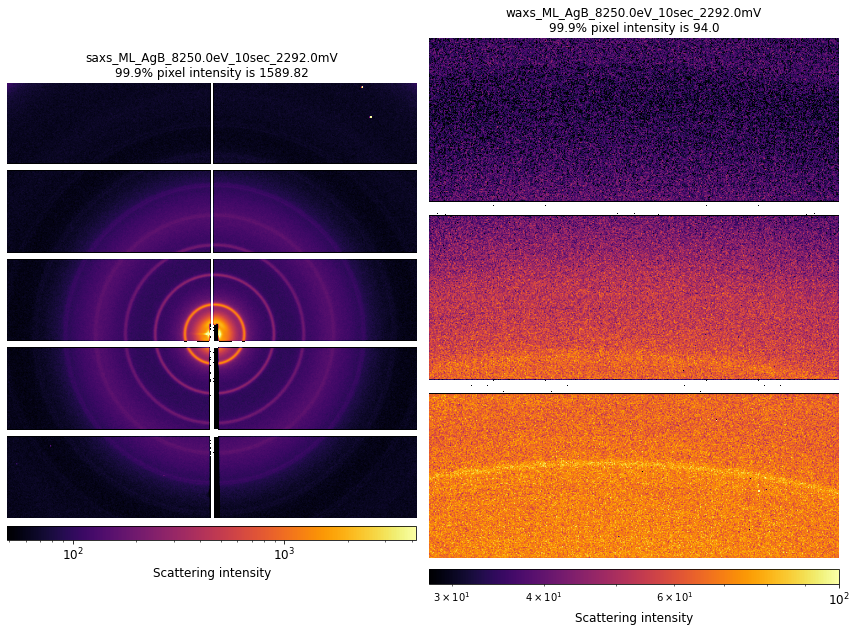

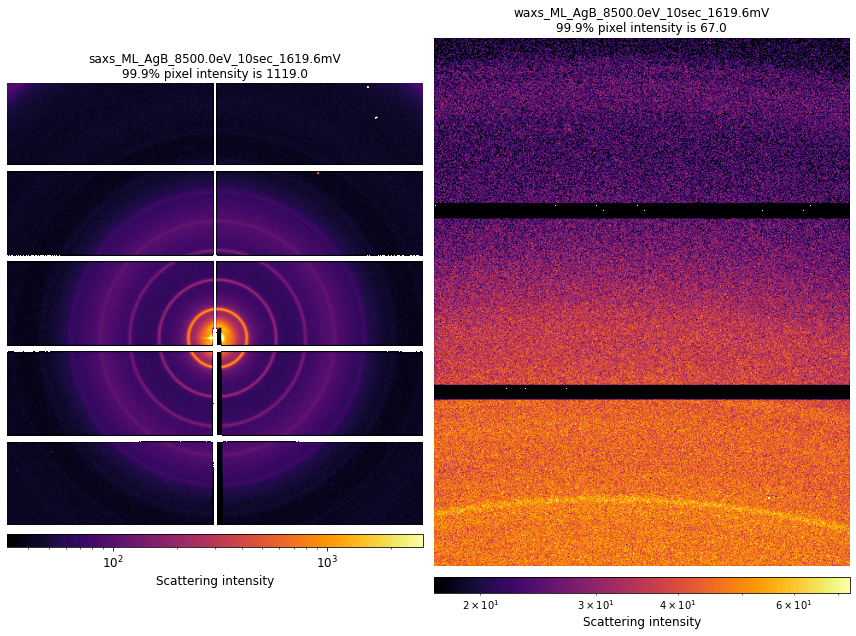

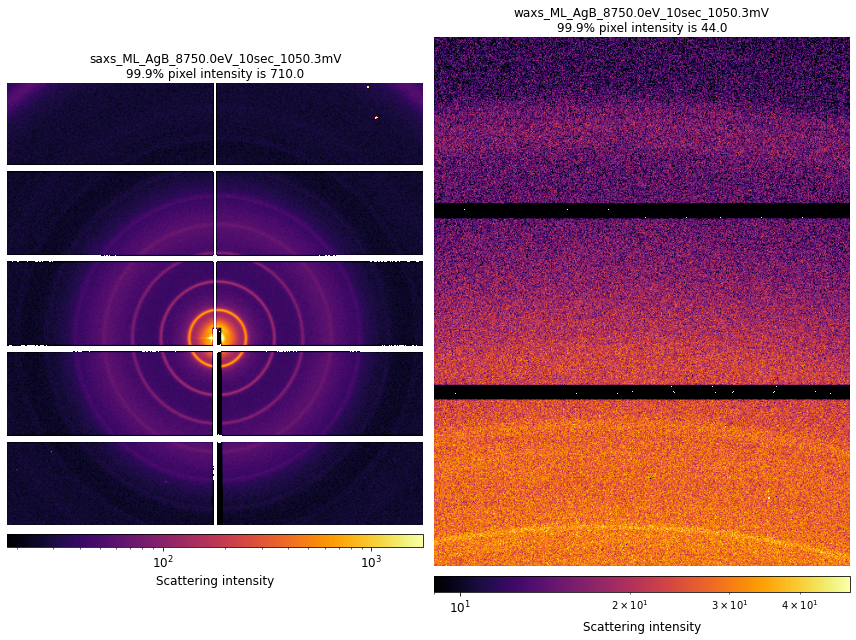

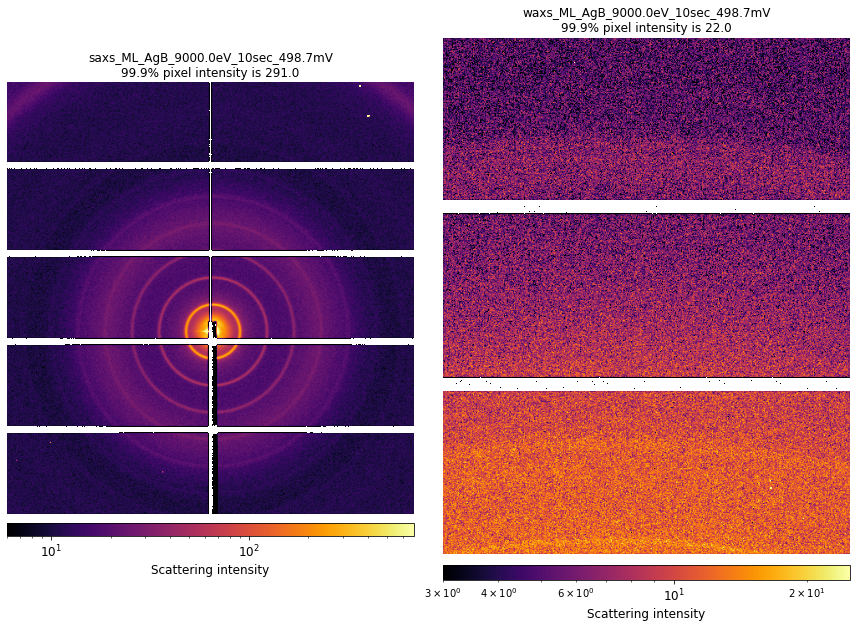

In [112]:
# actual AgB scab biw - energy scan to collect SAXS and WAXS across broad range

# ---------------------------------------------------------------------------------------------------------------------------------------------------------
# input sample info for file naming
user = 'ML'
sample = 'AgB'
#sample = 'test'

save_dir = '20240525ML_commissioning'

# input exposure times (seconds)
aqtime_saxs = 10
aqtime_waxs = 10
# ---------------------------------------------------------------------------------------------------------------------------------------------------------

energy_list = [5000, 5250, 5500, 5750, 6000, 6250, 6500, 6750, 7000, 7250, 7500, 7750, 8000, 8250, 8500, 8750, 9000]

for energy in energy_list:

    epics.caput('bl531_xps1:mono_angle_deg', mono_deg(energy))
    time_sleep(5)

    # additional file string info
    save_path = f'/mnt/data531/{save_dir}'
    os.makedirs(save_path, exist_ok=True)
    energy = np.round(energy_eV(epics.caget('bl531_xps1:mono_angle_deg')), 2)
    beamstop_current = np.abs(np.round(epics.caget('bl201-beamstop:current'), 2))

    # saxs single image acquisition
    epics.caput('13PIL1:cam1:AcquireTime', aqtime_saxs * 1.5)
    epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_saxs)
    epics.caput('13PIL1:cam1:FileName', f'{save_dir}/saxs_{user}_{sample}_{energy}eV_{aqtime_saxs}sec_{beamstop_current}mV')
    epics.caput('13PIL1:cam1:Acquire',1)
    if aqtime_saxs < 2.5:
        time_sleep(5)
    else:
        time_sleep(aqtime_saxs * 2)
    last_filename_saxs_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
    last_filename_saxs = bytes(last_filename_saxs_ascii).decode()
    print(last_filename_saxs)

    # waxs single image acquisition
    epics.caput('pilatus300k:cam1:AcquireTime', aqtime_waxs * 1.5)
    epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_waxs)
    epics.caput('pilatus300k:cam1:FileName', f'{save_dir}/waxs_{user}_{sample}_{energy}eV_{aqtime_waxs}sec_{beamstop_current}mV')
    epics.caput('pilatus300k:cam1:Acquire',1)
    if aqtime_waxs < 2.5:
        time_sleep(5)
    else:
        time_sleep(aqtime_waxs * 2)
    last_filename_waxs_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
    last_filename_waxs = bytes(last_filename_waxs_ascii).decode()
    print(last_filename_waxs)


    # display 2d images
    fig, ax = plt.subplots(1, 2, figsize=(12, 10))
    #saxs
    image_saxs_data = Image.open(last_filename_saxs[:-1])
    im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
    if np.percentile(im_saxs_np, 10) < 1:
        im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', vmin=np.percentile(im_saxs_np, 10), vmax=np.percentile(im_saxs_np, 99.9), aspect='equal')
    else:
        im_saxs = ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_saxs_np, 10)), vmax=(np.percentile(im_saxs_np, 99.99))), aspect='equal')
    ax[0].axis('off')
    title = os.path.basename(last_filename_saxs).split('.tif')[0]
    intensity_99percent = np.round(np.percentile(im_saxs_np, 99.9),2)
    ax[0].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
    ax_divider0 = make_axes_locatable(ax[0])
    cax0 = ax_divider0.append_axes('bottom', size='3%', pad='2%')
    plt.colorbar(im_saxs, cax=cax0, orientation='horizontal')
    cax0.set_xlabel('Scattering intensity', size=12)
    cax0.xaxis.set_label_position('bottom')
    cax0.xaxis.tick_bottom()
    cax0.xaxis.set_tick_params(labelsize=12)
    print(f'99.9% intensity on saxs detector at {energy} is {intensity_99percent}')

    #waxs
    image_waxs_data = Image.open(last_filename_waxs[:-1])
    im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
    if np.percentile(im_waxs_np, 10) < 1:
        im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', vmin=np.percentile(im_waxs_np, 10), vmax=np.percentile(im_waxs_np, 99.9), aspect='equal')
    else:
        im_waxs = ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm(vmin=(np.percentile(im_waxs_np, 10)), vmax=(np.percentile(im_waxs_np, 99.99))), aspect='equal')
    ax[1].axis('off')
    title = os.path.basename(last_filename_waxs).split('.tif')[0]
    intensity_99percent = np.round(np.percentile(im_waxs_np, 99.9),2)
    ax[1].set_title(f'{title}\n99.9% pixel intensity is {intensity_99percent}', size=12)
    ax_divider1 = make_axes_locatable(ax[1])
    cax1 = ax_divider1.append_axes('bottom', size='3%', pad='2%')
    plt.colorbar(im_waxs, cax=cax1, orientation='horizontal')
    cax1.set_xlabel('Scattering intensity', size=12)
    cax1.xaxis.set_label_position('bottom')
    cax1.xaxis.tick_bottom()
    cax1.xaxis.set_tick_params(labelsize=12)
    print(f'99.9% intensity on waxs detector at {energy} is {intensity_99percent}')

    fig.tight_layout()
    



In [122]:
image_files = sorted(f for f in os.listdir(save_path) if 'AgB' in f)
image_files

['saxs_ML_AgB_5000.0eV_10sec_106.52mV.tif',
 'saxs_ML_AgB_5000.0eV_10sec_107.27mV.tif',
 'saxs_ML_AgB_5250.0eV_10sec_124.76mV.tif',
 'saxs_ML_AgB_5500.0eV_10sec_160.92mV.tif',
 'saxs_ML_AgB_5750.0eV_10sec_336.9mV.tif',
 'saxs_ML_AgB_6000.0eV_10sec_712.1mV.tif',
 'saxs_ML_AgB_6250.0eV_10sec_1140.3mV.tif',
 'saxs_ML_AgB_6500.0eV_10sec_1556.9mV.tif',
 'saxs_ML_AgB_6750.0eV_10sec_2010.8mV.tif',
 'saxs_ML_AgB_7000.0eV_10sec_2475.0mV.tif',
 'saxs_ML_AgB_7250.0eV_10sec_2906.0mV.tif',
 'saxs_ML_AgB_7500.0eV_10sec_3303.0mV.tif',
 'saxs_ML_AgB_7750.0eV_10sec_3632.0mV.tif',
 'saxs_ML_AgB_8000.0eV_10sec_3889.0mV.tif',
 'saxs_ML_AgB_8250.0eV_10sec_2292.0mV.tif',
 'saxs_ML_AgB_8500.0eV_10sec_1619.6mV.tif',
 'saxs_ML_AgB_8750.0eV_10sec_1050.3mV.tif',
 'saxs_ML_AgB_9000.0eV_10sec_498.7mV.tif',
 'waxs_ML_AgB_5000.0eV_10sec_106.52mV.tif',
 'waxs_ML_AgB_5250.0eV_10sec_124.76mV.tif',
 'waxs_ML_AgB_5500.0eV_10sec_160.92mV.tif',
 'waxs_ML_AgB_5750.0eV_10sec_336.9mV.tif',
 'waxs_ML_AgB_6000.0eV_10sec_712.1mV

AssertionError: 

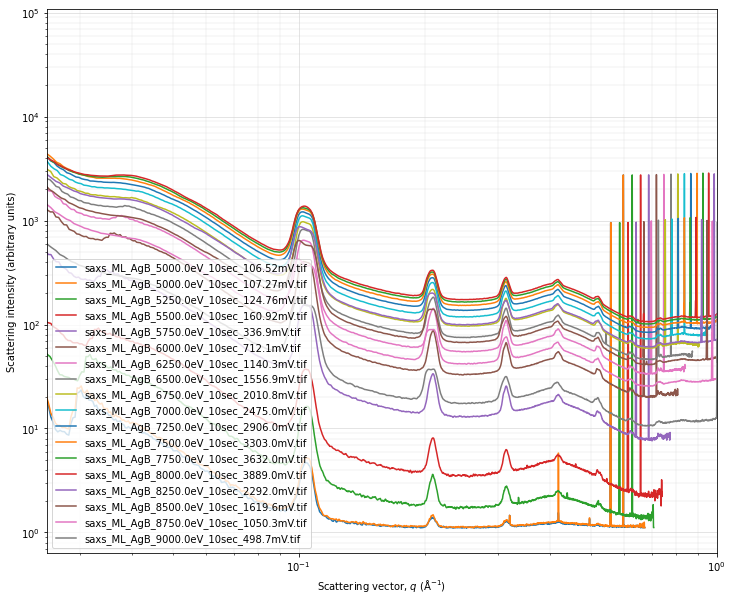

In [124]:
# plotting radially-integrated profiles 


az_range=[-180,180]
fig, ax = plt.subplots(figsize=(12,10))

# mrl measured 49 mm as sample-detector distance using a measuring tape
dist = 0.49

bc_x = 495
bc_y = 600


# rough beam center position using 2d image / scatter point above
poni1 = bc_y * 0.000172
poni2 = bc_x * 0.000172



mask_path = '/home/bl531/bl531_commissioning/20240522ML_commissioning/saxs_mask_mrl.edf'


rot1 = 0
rot2 = 0
rot3 = 0

for file in image_files[:]:
    
 
    # radial integration of a single pilatus saxs image

    filepath = os.path.join(save_path, file)

    energy = float(file[file.find('eV') - 6 : file.find('eV')])

    wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
    calibrant = pyFAI.calibrant.get_calibrant("AgBh")
    calibrant.wavelength = wavelength
    detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
    ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
    ai.maskfile = mask_path

    im_path = os.path.join(filepath)
    im_data = fabio.open(im_path)
    im_array = im_data.data
    im_array[im_array < 1] = 1
    im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
    qvector = im_reduced[0] / 10
    intensity = im_reduced[1] # / diode_value

    #log_intensity = np.log10(intensity)
    #log_intensity_offset = log_intensity - 1 * idx
    #intensity_offset = 10**(log_intensity_offset)
    #intensity = intensity_offset

    #qvector_list.append(qvector)
    #radint_list.append(intensity)
    #energy_list.append(energy)
    energy_rounded = round(energy, 0)
    ax.plot(qvector, intensity, label=file)#, label=f'{energy_rounded} eV')
    ax.set_xscale('log')
    ax.set_yscale('log')    
    ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
    ax.set_ylabel('Scattering intensity (arbitrary units)')
    ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
    ax.legend()

    #ax.set_xlim([0.025, 1])
   # ax.set_ylim([4, 300])

    #if flag_save:
    #    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
    #    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
    #    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
    #    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [470]:
bc_x * 0.000172

0.08514000000000001

In [463]:
filepath

'/mnt/data531/20240524ML_commissioning/kelvin/saxs_ML_kevlin-PAPPS-9_8000.0eV_10sec_2285.0mV_rep2.tif\x00'

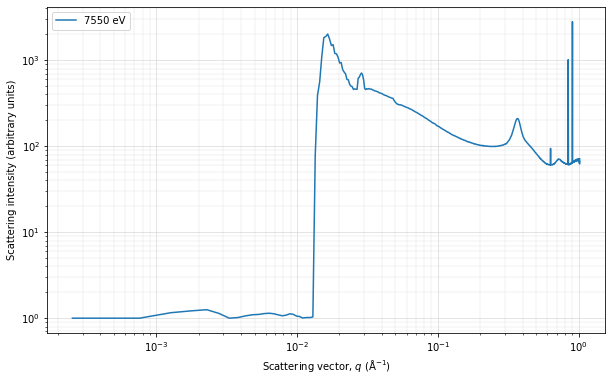

In [472]:
# radial integration of a single pilatus saxs image

filepath = last_filename_saxs[:-1]

az_range=[-180,180]
fig, ax = plt.subplots(figsize=(10,6))


# mrl measured 49 mm as sample-detector distance using a measuring tape
dist = 0.49
# rough beam center position using 2d image / scatter point above
poni1 = bc_y * 0.000172
poni2 = bc_x * 0.000172

rot1 = 0
rot2 = 0
rot3 = 0


wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
calibrant = pyFAI.calibrant.get_calibrant("AgBh")
calibrant.wavelength = wavelength
detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
#ai.maskfile = os.path.join(master_path, 'waxs_mask_mrl_april2024.edf')

im_path = os.path.join(filepath)
im_data = fabio.open(im_path)
im_array = im_data.data
im_array[im_array < 1] = 1
im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
qvector = im_reduced[0] / 10
intensity = im_reduced[1] # / diode_value

#log_intensity = np.log10(intensity)
#log_intensity_offset = log_intensity - 1 * idx
#intensity_offset = 10**(log_intensity_offset)
#intensity = intensity_offset

#qvector_list.append(qvector)
#radint_list.append(intensity)
#energy_list.append(energy)
energy_rounded = round(energy, 0)
ax.plot(qvector, intensity, label=)#, label=f'{energy_rounded} eV')
ax.set_xscale('log')
ax.set_yscale('log')    
#ax.set_title(f'Fe(OH)3 Sample\nRadially integrated WAXS profile\nEnergy={energy} eV')
ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
ax.set_ylabel('Scattering intensity (arbitrary units)')
ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
ax.legend()
plt.show()

#if flag_save:
#    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
#    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
#    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
#    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [391]:
np.percentile(im_saxs_np, 99.9)

2552.0

In [390]:
np.percentile(im_waxs_np, 99.9)

86.0

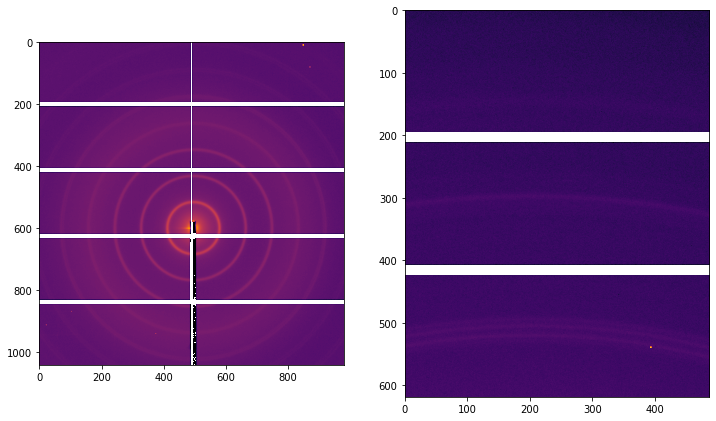

In [389]:

fig, ax = plt.subplots(1, 2, figsize=(12, 10))

image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm())


image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm())



AttributeError: 'numpy.ndarray' object has no attribute 'get_array'

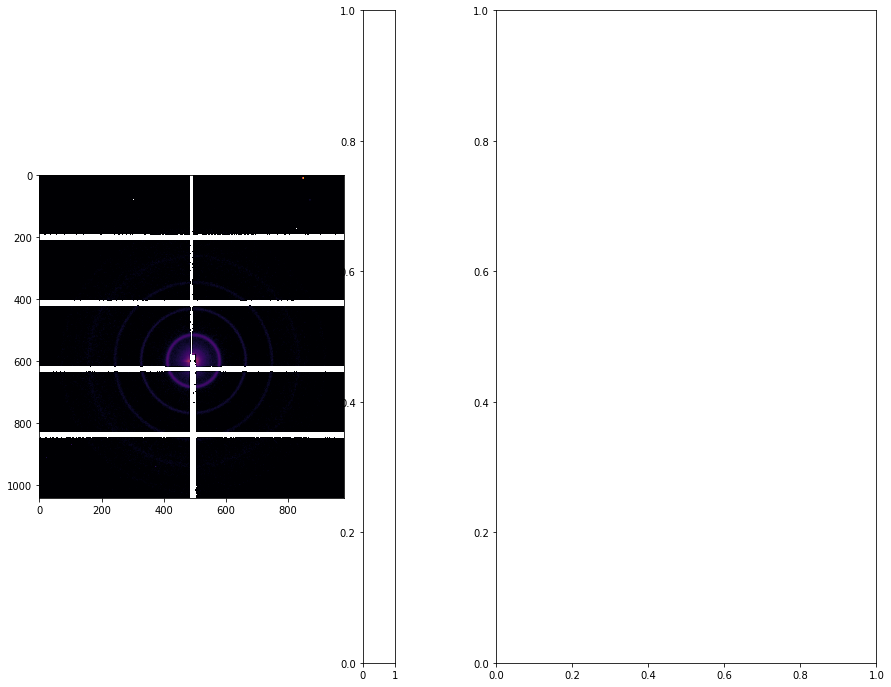

In [374]:
fig, ax = plt.subplots(1, 2, figsize=(15, 12))

image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm())
#plt.colorbar(im_saxs_np, ax=ax[0])




image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm())

In [ ]:

# display 2d images
# include scalebar
plt.subplots(2, 1)



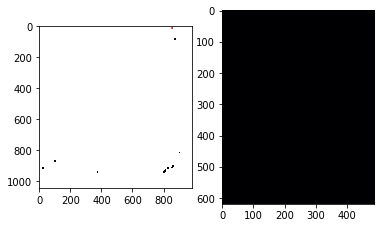

In [369]:
fig, ax = plt.subplots(1, 2)

image_saxs_data = Image.open(last_filename_saxs[:-1])
im_saxs_np = np.squeeze(np.array(image_saxs_data.getdata()).reshape(image_saxs_data.size[1], image_saxs_data.size[0], 1))
ax[0].imshow(im_saxs_np, cmap = 'inferno', norm=LogNorm())


image_waxs_data = Image.open(last_filename_waxs[:-1])
im_waxs_np = np.squeeze(np.array(image_waxs_data.getdata()).reshape(image_waxs_data.size[1], image_waxs_data.size[0], 1))
ax[1].imshow(im_waxs_np, cmap = 'inferno', norm=LogNorm())



#fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
#extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

#plt.xlabel('horizontal Position [mm]')
#plt.ylabel('vertical Positon [mm]')
#plt.show()







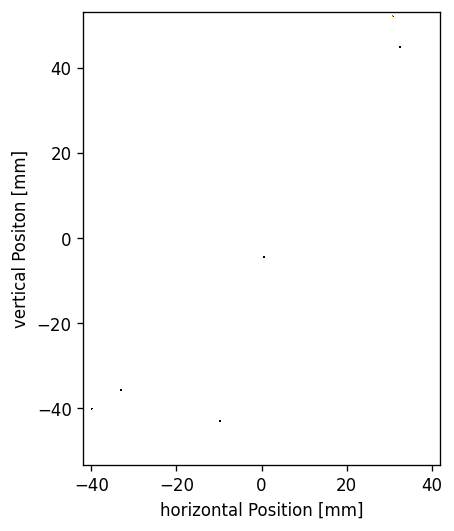

In [361]:
filepath = last_filename_saxs[:-1]


# read the image
im_tiff = Image.open(filepath)
# make the image a numpy array so that we can process it
im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))

# dealing with dyanmic range
#im_np[np.where(im_np>100000.0)] =0

dx_m = 172e-6
Nx_px = 487
Ny_px = 619
Dx_m = Nx_px*dx_m
Dy_m = Ny_px*dx_m

fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

plt.imshow(im_np, extent=extent, cmap = 'inferno', norm=LogNorm())
plt.xlabel('horizontal Position [mm]')
plt.ylabel('vertical Positon [mm]')
plt.show()

In [292]:
# single image acquisition on saxs detector


aqtime_s_waxs = 0.1
epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)



cannot connect to 13PIL1:cam1:AcquireTime
cannot connect to 13PIL1:cam1:AcquirePeriod
cannot connect to 13PIL1:cam1:Acquire
cannot connect to 13PIL1:cam1:FullFileName_RBV


TypeError: cannot convert 'NoneType' object to bytes

In [228]:
# single image acquisition on waxs detector


epics.caput('pilatus300k:cam1:FileName', f'waxs_{user}_{sample}_{energy}eV_{aqtime}sec_{beamstop_current}mV')

aq_waxs


aqtime_s = 10
epics.caput('pilatus300k:cam1:AcquireTime', aqtime_s * 1.5)
epics.caput('pilatus300k:cam1:AcquirePeriod', aqtime_s)
epics.caput('pilatus300k:cam1:Acquire',1)
time_sleep(5)

last_filename_ascii = epics.caget('pilatus300k:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

/mnt/data531/WAXS531_20240523_AgB_003.tif 


In [235]:
epics.caput('pilatus300k:cam1:FileName', 'scream')

1

In [296]:
epics.caget('13PIL1:cam1:FileName')

cannot connect to 13PIL1:cam1:FileName


In [295]:
epics.caget('pilatus300k:cam1:FileName')

array([115,  99, 114, 101,  97, 109,   0], dtype=uint8)

In [218]:
last_filename

'/mnt/data531/testabc_4824.tif\x00'

In [219]:
filepath = last_filename[:-1]


# read the image
im_tiff = Image.open(filepath)
# make the image a numpy array so that we can process it
im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))

# dealing with dyanmic range
#im_np[np.where(im_np>100000.0)] =0

dx_m = 172e-6
Nx_px = 487
Ny_px = 619
Dx_m = Nx_px*dx_m
Dy_m = Ny_px*dx_m

fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

plt.imshow(im_np, extent=extent, cmap = 'inferno', norm=LogNorm())
plt.xlabel('horizontal Position [mm]')
plt.ylabel('vertical Positon [mm]')
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data531/testabc_4824.tif'

In [ ]:
# combined nexafs + saxs + waxs energy scan



energy_list = np.linspace(6950, 7150, 101)



epics.caput('bl531_xps1:mono_angle_deg',mono_deg(energy_list[0]))

time_sleep(5)

filenames = ()

for i_e in tqdm(range(len(energy_list))):

    mono_angle_deg = mono_deg(energy_list[i_e])
    
    epics.caput('bl531_xps1:mono_angle_deg',mono_angle_deg)
    time_sleep(2)


    aqtime_s = 2
    epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
    epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
    epics.caput('13PIL1:cam1:Acquire',1)
    time_sleep(5)

    last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
    last_filename = bytes(last_filename_ascii).decode()
    filenames += (last_filename,)





In [ ]:
# saxs energy scan

Es_eV = np.linspace(6950, 7150, 101)        # same energy range/resolution as nexafs



epics.caput('bl531_xps1:mono_angle_deg',mono_deg(Es_eV[0]))
time_sleep(5)
filenames = ()
for i_e in tqdm(range(len(Es_eV))):
    mono_angle_deg = mono_deg(Es_eV[i_e])
    
    epics.caput('bl531_xps1:mono_angle_deg',mono_angle_deg)
    time_sleep(2)


    aqtime_s = 2
    epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
    epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
    epics.caput('13PIL1:cam1:Acquire',1)
    time_sleep(5)

    last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
    last_filename = bytes(last_filename_ascii).decode()
    filenames += (last_filename,)



In [ ]:
# single image acquisition on saxs detector
aqtime_s = 0.1
epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)

epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

In [276]:
mono_angle_deg = mono_deg(8000)
epics.caput('bl531_xps1:mono_angle_deg', mono_angle_deg)

1

In [275]:
mono_angle_deg = mono_deg(8000)
print(mono_angle_deg)

27.097538443499513


In [ ]:
# not getting very good Cu K-edge NEXAFS... might be the samples... lets move on for now

In [ ]:
# --------------------------------------------------------------------------------------------------------------------------------------------------------------
# lets get MAXS (medium angle x-ray scattering, detector pushed forward) on cameron's polyamide samples
# bar 2 
    # cameron01 - Pristine XLE
    # cameron00 - 
    # cameron02 - SNOM+Na



In [125]:
# Cu K-edge NEXAFS scan

input_energies = np.linspace(8750, 8950, 201)   # nexafs Cu K-edge

time_sleep_variable = 1


mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)    
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4


file_name = 'cu_test_may17_1'
np.savetxt(f'/home/bl531/bl531_commissioning/20240424ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')







 82%|████████▏ | 164/201 [16:25<03:42,  6.01s/it]


KeyboardInterrupt: 

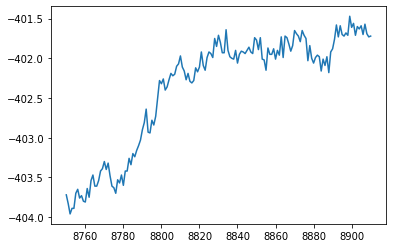

In [126]:
plt.plot(input_energies[:-40], pd_val_nA[:-40])

In [ ]:
# 5/17/24
# new bar with AgB, CuAc, Cr(III) oxide


In [ ]:
# Fe K-edge NEXAFS scan

input_energies = np.linspace(6950, 7150, 101)   # nexafs

time_sleep_variable = 1


mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0
epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in tqdm(np.arange(len(mono_angles_deg))):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(time_sleep_variable*2)
    nexafs_reading_1 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_2 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_3 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)
    nexafs_reading_4 = epics.caget('bl201-beamstop:current')
    time_sleep(time_sleep_variable)    
    pd_val_nA[i_a] = nexafs_reading_1 + nexafs_reading_2 + nexafs_reading_3 + nexafs_reading_4


file_name = 'fe_test_may16'
np.savetxt(f'/home/bl531/bl531_commissioning/20240424ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

print('done')







In [124]:
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(9000))


1

In [107]:
mono_deg(3000)

54.02126444371078

In [95]:
energy_eV = lambda mono_deg_input: (mono_deg_input - mono_offset_deg)
energy_eV(28.93957213521199)

In [104]:
mono_deg(6750)

29.821699155862255

In [59]:
epics.caget('bl531_xps2:beamstop_x_mm')

11.8

In [63]:
epics.caput('bl531_xps2:beamstop_x_mm', 12.5)

1

In [91]:
epics.caput('bl531_xps1:mono_angle_deg', mono_deg(7000))


1

In [94]:
epics.caget('bl531_xps1:mono_angle_deg')


28.93957213521199

In [ ]:

np.savetxt(f'/home/bl531/bl531_commissioning/20240424ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)


In [ ]:
# lets look at the nexafs scans

mrl_save_path = '/home/bl531/bl531_commissioning/20240507ML_commissioning/'

spectra_files = sorted(f for f in os.listdir(mrl_save_path) if '_CuKedge' in f)

fig, ax = plt.subplots(figsize=(6,5))

for spec in spectra_files:
    spec_data = np.loadtxt(os.path.join(mrl_save_path, spec))

    energy = spec_data[:,0]
    mono_angle = spec_data[:,1]
    photodiode = spec_data[:,2]


    ax.plot(energy, photodiode, label=spec)
    #ax.set_xlim([8800, 8880])
   # ax.legend()

In [ ]:
# --------------------------------------------------------------------------------------------------------------------------------------------------------------------
# saxs


In [ ]:
# single image acquisition on saxs detector
aqtime_s = 0.1
epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

In [ ]:
# display 2d image 

#filepath = '/mnt/pilatus/' + 'BinaryNP_231222_WAXS_4802.tif'
#filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan08_saxs_tulasi-PET-SeNP2_4899.tif'
filepath = last_filename[:-1]
filepath = '/mnt/data531/saxs_AgB_8650eV_1sec_5035.tif'

# read the image
im_tiff = Image.open(filepath)
# make the image a numpy array so that we can process it
im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))

# dealing with dyanmic range
#im_np[np.where(im_np>100000.0)] =0

dx_m = 172e-6
Nx_px = 981
Ny_px = 1043
Dx_m = Nx_px*dx_m
Dy_m = Ny_px*dx_m

fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

plt.imshow(im_np, extent=extent, cmap = 'inferno', norm=LogNorm())
plt.xlabel('horizontal Position [mm]')
plt.ylabel('vertical Positon [mm]')
plt.show()

np.percentile(im_np,99.999)   # this value should be below 1 million


In [ ]:
# lets look at the nexafs scans

mrl_save_path = '/home/bl531/bl531_commissioning/20240424ML_commissioning/'

spectra_files = sorted(f for f in os.listdir(mrl_save_path) if '_nexafs' in f)

fig, ax = plt.subplots(figsize=(6,5))

for spec in spectra_files:
    spec_data = np.loadtxt(os.path.join(mrl_save_path, spec))

    energy = spec_data[:,0]
    mono_angle = spec_data[:,1]
    photodiode = spec_data[:,2]


    ax.plot(energy, photodiode, label=spec)
   # ax.legend()

In [ ]:
# pilatus single image acquisition
aqtime_s = 4
epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

In [ ]:
# display 2d image 


filepath = last_filename[:-1]
#filepath = '/mnt/data531/scan05_saxs_FeOH3_2sec_5141.tif'
filepath = '/mnt/data531/scan05_saxs_FeOH3_2sec_5141.tif'


# read the image
im_tiff = Image.open(filepath)
# make the image a numpy array so that we can process it
im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))

# dealing with dyanmic range
#im_np[np.where(im_np>100000.0)] =0

dx_m = 172e-6
Nx_px = 981
Ny_px = 1043
Dx_m = Nx_px*dx_m
Dy_m = Ny_px*dx_m

fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

plt.imshow(im_np, extent=extent, cmap = 'inferno', norm=LogNorm())
plt.xlabel('horizontal Position [mm]')
plt.ylabel('vertical Positon [mm]')
plt.show()

In [ ]:
# radial integration of a single pilatus image

#filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan07_saxs_tulasi-PET-ctrl_10000eV/scan07_saxs_tulasi-PET-ctrl_4891.tif'
#filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan08_saxs_tulasi-PET-SeNP2_dark_4898.tif'
#filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan08_saxs_tulasi-PET-SeNP2_4899.tif'

az_range=[-180,180]
fig, ax = plt.subplots(figsize=(10,6))
#qvector_list = []
#radint_list = []
#energy_list = []
#for idx, image in tqdm(enumerate(images[:])):

#mono_angle = float(image[ image.find('deg') - 4: image.find('deg')])
#energy = calculate_output_energy(mono_angle)

# calibration performed in pyfai-calib2 by mrl on 4/22/24
dist = 1.47
poni1 = 0.10065476219862225
poni2 = 0.07695294434659085
rot1 = 0
rot2 = 0
rot3 = 0

energy = 7550

wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
calibrant = pyFAI.calibrant.get_calibrant("AgBh")
calibrant.wavelength = wavelength
detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
#ai.maskfile = os.path.join(master_path, 'waxs_mask_mrl_april2024.edf')

im_path = os.path.join(filepath)
im_data = fabio.open(im_path)
im_array = im_data.data
im_array[im_array < 1] = 1
im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
qvector = im_reduced[0] / 10
intensity = im_reduced[1] # / diode_value

#log_intensity = np.log10(intensity)
#log_intensity_offset = log_intensity - 1 * idx
#intensity_offset = 10**(log_intensity_offset)
#intensity = intensity_offset

#qvector_list.append(qvector)
#radint_list.append(intensity)
#energy_list.append(energy)
energy_rounded = round(energy, 0)
ax.plot(qvector, intensity, label=f'{energy_rounded} eV')
ax.set_xscale('log')
ax.set_yscale('log')    
#ax.set_title(f'Fe(OH)3 Sample\nRadially integrated WAXS profile\nEnergy={energy} eV')
ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
ax.set_ylabel('Scattering intensity (arbitrary units)')
ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
ax.legend()
plt.show()

#if flag_save:
#    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
#    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
#    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
#    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [ ]:
# saxs energy scan

Es_eV = np.linspace(6950, 7150, 101)        # same energy range/resolution as nexafs



epics.caput('bl531_xps1:mono_angle_deg',mono_deg(Es_eV[0]))
time_sleep(5)
filenames = ()
for i_e in tqdm(range(len(Es_eV))):
    mono_angle_deg = mono_deg(Es_eV[i_e])
    
    epics.caput('bl531_xps1:mono_angle_deg',mono_angle_deg)
    time_sleep(2)


    aqtime_s = 2
    epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
    epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
    epics.caput('13PIL1:cam1:Acquire',1)
    time_sleep(5)

    last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
    last_filename = bytes(last_filename_ascii).decode()
    filenames += (last_filename,)



In [ ]:
np.percentile(im_np, 99.99)

In [ ]:
epics.caget('bl531_xps1:mono_angle_deg')

In [ ]:
mono_deg(7150)

In [ ]:
img = ()
for i_e in range(len(Es_eV)):
    filepath = filenames[i_e][:-1]
    # read the image
    im_tiff = Image.open(filepath)
    # make the image a numpy array so that we can process it
    im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))
    img += (im_np,)


In [ ]:
# tracking flux on top of detector to see if we can see fluorescence nexafs

fig, ax = plt.subplots()

flux = Es_eV*0
for i_e in range(len(Es_eV)):
    flux[i_e] = np.sum(img[i_e][0:200, 0:200])

ax.plot(Es_eV, flux)
#ax.set_xlim([0,100])
#ax.set_ylim([2.4e6, 2.8e6])


In [ ]:
# ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
# below is the code from april 22, 2024

In [ ]:
# execute nexafs scan (to collect on photodiode) across an inputted energy range

input_energies = np.linspace(8965, 8995, 101)
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0

epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in np.arange(len(mono_angles_deg)):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(0.5)
    pd_val_nA[i_a] = epics.caget('bl201-beamstop:current')

In [ ]:
# make a quick plot of the photodiode signal

plt.plot(input_energies,pd_val_nA)
plt.xlabel('Beamline Energy (eV)')
plt.ylabel('Beamstop Diode Intensity [nA]')
plt.show()

# save data since photodiode signals are not archived (i think)!
file_name = 'scan01_nexafs_CopperFoil_photodiode'
#file_name = 'scan02_nexafs_CopperFoil_photodiode_dark'
#file_name = 'scan03_nexafs_CopperFoil_photodiode_dark2'

#np.savetxt(f'/home/bl531/bl531_commissioning/20240422ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

In [ ]:
# ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
# now i've pulled vacuum on a direct beam sample
# and i ran tulasis two PET-SeNP samples using these cells

In [ ]:
# lets do a wide energy scan on the photodiode to see what the bkg on is for a direct beam   

input_energies = np.linspace(5000, 11000, 201)
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0

epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in np.arange(len(mono_angles_deg)):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(0.5)
    pd_val_nA[i_a] = epics.caget('bl201-beamstop:current')


# make a quick plot of the photodiode signal
plt.plot(input_energies,pd_val_nA)
plt.xlabel('Beamline Energy (eV)')
plt.ylabel('Beamstop Diode Intensity [nA]')
plt.show()

# save data since photodiode signals are not archived (i think)!
file_name = 'scan04_nexafs_directbeam_photodiode_dark'
file_name = 'scan05_nexafs_directbeam_photodiode'

#np.savetxt(f'/home/bl531/bl531_commissioning/20240422ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

In [ ]:
# pilatus time :)  single image acquisition
aqtime_s = 1
epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
epics.caput('13PIL1:cam1:Acquire',1)
time_sleep(5)
last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
last_filename = bytes(last_filename_ascii).decode()
print(last_filename)

In [ ]:
# display 2d image 

#filepath = '/mnt/pilatus/' + 'BinaryNP_231222_WAXS_4802.tif'
#filepath = '/mnt/pilatus/' + 'FeNOM_20231221_3756.tif'
#filepath = 'afp://bl531user@bl531data.local/User_Data/' + last_filename[13:-1]
filepath = f'/home/bl531/bl531_commissioning/20240422ML_commissioning/{last_filename[13:-1]}'
#filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan06_saxs_directbeam_5000-11000eV/scan06_saxs_directbeam_4882.tif'
filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan07_saxs_tulasi-PET-ctrl_4894.tif'
filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan08_saxs_tulasi-PET-SeNP2_4899.tif'


# read the image
im_tiff = Image.open(filepath)
# make the image a numpy array so that we can process it
im_np = np.squeeze(np.array(im_tiff.getdata()).reshape(im_tiff.size[1], im_tiff.size[0], 1))

# dealing with dyanmic range
#im_np[np.where(im_np>100000.0)] =0

dx_m = 172e-6
Nx_px = 981
Ny_px = 1043
Dx_m = Nx_px*dx_m
Dy_m = Ny_px*dx_m

fig=plt.figure(figsize=(5, 5), dpi= 120, facecolor='w', edgecolor='k')
extent = (-Dx_m/2 * 1e3, +Dx_m/2 * 1e3, -Dy_m/2 * 1e3, +Dy_m/2 * 1e3)

#mask = im_np > np.max(im_np)
#im_np[mask]=0

plt.imshow(im_np, extent=extent, cmap = 'inferno', norm=LogNorm())
plt.xlabel('horizontal Position [mm]')
plt.ylabel('vertical Positon [mm]')
plt.show()

In [ ]:
# check that you are not oversaturating detector... if so, adjust exposure time 

np.percentile(im_np,99.9)   # this value should be below 1 million

In [ ]:
# pilatus energy scan

Es_eV = np.linspace(5000, 11000, 61)

epics.caput('bl531_xps1:mono_angle_deg',mono_deg(Es_eV[0]))
time_sleep(5)
filenames = ()
for i_e in range(len(Es_eV)):
    mono_angle_deg = mono_deg(Es_eV[i_e])
    
    epics.caput('bl531_xps1:mono_angle_deg',mono_angle_deg)
    time_sleep(2)

    aqtime_s = 1
    epics.caput('13PIL1:cam1:AcquireTime', aqtime_s * 1.5)
    epics.caput('13PIL1:cam1:AcquirePeriod', aqtime_s)
    epics.caput('13PIL1:cam1:Acquire',1)
    time_sleep(5)

    last_filename_ascii = epics.caget('13PIL1:cam1:FullFileName_RBV')
    last_filename = bytes(last_filename_ascii).decode()[13:-1]
    filenames += (last_filename,)


In [ ]:
# radial integration of a single pilatus image

filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan07_saxs_tulasi-PET-ctrl_10000eV/scan07_saxs_tulasi-PET-ctrl_4891.tif'
filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan08_saxs_tulasi-PET-SeNP2_dark_4898.tif'
filepath = '/home/bl531/bl531_commissioning/20240422ML_commissioning/scan08_saxs_tulasi-PET-SeNP2_4899.tif'

az_range=[-180,180]
fig, ax = plt.subplots(figsize=(10,6))
#qvector_list = []
#radint_list = []
#energy_list = []
#for idx, image in tqdm(enumerate(images[:])):
mono_angle = 24.19
energy = 10000
#mono_angle = float(image[ image.find('deg') - 4: image.find('deg')])
#energy = calculate_output_energy(mono_angle)

# calibration performed in pyfai-calib2 by mrl on 4/22/24
dist = 1.47
poni1 = 0.10065476219862225
poni2 = 0.07695294434659085
rot1 = 0
rot2 = 0
rot3 = 0

wavelength = ( (4.1357 * (10**-15)) * (2.9979 * (10**8))) / energy
calibrant = pyFAI.calibrant.get_calibrant("AgBh")
calibrant.wavelength = wavelength
detector = pyFAI.detectors.Pilatus1M(pixel1=0.000172, pixel2=0.000172, max_shape=(1043, 981))
ai = AzimuthalIntegrator(dist=dist, detector=detector, wavelength=wavelength, poni1=poni1, poni2=poni2, rot1=rot1, rot2=rot2, rot3=rot3)
#ai.maskfile = os.path.join(master_path, 'waxs_mask_mrl_april2024.edf')

im_path = os.path.join(filepath)
im_data = fabio.open(im_path)
im_array = im_data.data
im_array[im_array < 1] = 1
im_reduced = ai.integrate1d(im_array, npt=2000, azimuth_range=az_range)
qvector = im_reduced[0] / 10
intensity = im_reduced[1] # / diode_value

#log_intensity = np.log10(intensity)
#log_intensity_offset = log_intensity - 1 * idx
#intensity_offset = 10**(log_intensity_offset)
#intensity = intensity_offset

#qvector_list.append(qvector)
#radint_list.append(intensity)
#energy_list.append(energy)
energy_rounded = round(energy, 0)
ax.plot(qvector, intensity, label=f'{energy_rounded} eV')
ax.set_xscale('log')
ax.set_yscale('log')    
#ax.set_title(f'Fe(OH)3 Sample\nRadially integrated WAXS profile\nEnergy={energy} eV')
ax.set_xlabel(r'Scattering vector, $q \ (\mathrm{\AA^{-1}})$')
ax.set_ylabel('Scattering intensity (arbitrary units)')
ax.grid(which='major', color='lightgrey', linewidth=0.6); ax.grid(which='minor', color='lightgrey', linewidth=0.3)
ax.legend()
plt.show()

#if flag_save:
#    path_saxs_plot = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.tif')
#    path_saxs_txt = os.path.join(save_path, f'{sample_folder}_saxs_{energy}eV.txt')
#    fig.savefig(path_saxs_plot, bbox_inches='tight', dpi=300)
#    np.savetxt(path_saxs_txt, np.vstack((qvector, intensity)).T)



In [ ]:
# ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
# now i have the Copper Foil back in the chamber and i pulled vacuum
# want to try some spectroscopy (NEXAFS, EXAFS) at Cu K-edge

In [ ]:
# lets look at the Cu K-edge

input_energies = np.linspace(8965, 8995, 101)
mono_angles_deg = mono_deg(input_energies)
pd_val_nA = mono_angles_deg*0

epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in np.arange(len(mono_angles_deg)):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(5)
    pd_val_nA[i_a] = epics.caget('bl201-beamstop:current')


# make a quick plot of the photodiode signal
plt.plot(input_energies,pd_val_nA)
plt.xlabel('Beamline Energy (eV)')
plt.ylabel('Beamstop Diode Intensity [nA]')
plt.show()

# save data since photodiode signals are not archived (i think)!
file_name = 'scan12_nexafs_CuFoil-vacuum_photodiode_5sec'



np.savetxt(f'/home/bl531/bl531_commissioning/20240422ML_commissioning/{file_name}.txt', np.vstack((input_energies, mono_angles_deg, pd_val_nA)).T)

In [ ]:
# 0.5 sec photodiode scan for reference (to compare to 5 sec scan above)

plt.plot(input_energies,pd_val_nA)
plt.xlabel('Beamline Energy (eV)')
plt.ylabel('Beamstop Diode Intensity [nA]')

plt.show()

In [ ]:
# ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
# antoines code from 20240422ML_calibration.ipynb

In [ ]:
# testing EPICS with the monochromator
epics.caget('bl531_xps1:mono_angle_deg')

In [ ]:

epics.caget('bl201-beamstop:current')

In [ ]:
import matplotlib.pyplot as plt
from time import sleep as time_sleep

mono_angles_deg = np.linspace(25,26,101)
pd_val_nA = mono_angles_deg*0


epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[0])
time_sleep(5)
for i_a in np.arange(len(mono_angles_deg)):
    epics.caput('bl531_xps1:mono_angle_deg', mono_angles_deg[i_a])
    time_sleep(0.5)
    pd_val_nA[i_a] = epics.caget('bl201-beamstop:current')




In [ ]:
plt.plot(mono_angles_deg,pd_val_nA)
plt.xlabel('Mono angle [deg]')
plt.ylabel('beamstop diode intensity [nA]')
plt.show()


In [ ]:
pd_val_nA